<a href="https://colab.research.google.com/github/mlajtos/SIREN-Interpolation/blob/main/SIREN-Interpolation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [4]:
import torch
from torch import nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset
import os

from PIL import Image
from torchvision.transforms import Resize, Compose, ToTensor, Normalize
import numpy as np
import skimage
import matplotlib.pyplot as plt

import time

def get_mgrid(sidelen, dim=2):
    '''Generates a flattened grid of (x,y,...) coordinates in a range of -1 to 1.
    sidelen: int
    dim: int'''
    tensors = tuple(dim * [torch.linspace(-1, 1, steps=sidelen)])
    mgrid = torch.stack(torch.meshgrid(*tensors), dim=-1)
    mgrid = mgrid.reshape(-1, dim)
    return mgrid

In [5]:
class SineLayer(nn.Module):
    # See paper sec. 3.2, final paragraph, and supplement Sec. 1.5 for discussion of omega_0.
    
    # If is_first=True, omega_0 is a frequency factor which simply multiplies the activations before the 
    # nonlinearity. Different signals may require different omega_0 in the first layer - this is a 
    # hyperparameter.
    
    # If is_first=False, then the weights will be divided by omega_0 so as to keep the magnitude of 
    # activations constant, but boost gradients to the weight matrix (see supplement Sec. 1.5)
    
    def __init__(self, in_features, out_features, bias=True,
                 is_first=False, omega_0=30):
        super().__init__()
        self.omega_0 = omega_0
        self.is_first = is_first
        
        self.in_features = in_features
        self.linear = nn.Linear(in_features, out_features, bias=bias)
        
        self.init_weights()
    
    def init_weights(self):
        with torch.no_grad():
            if self.is_first:
                self.linear.weight.uniform_(-1 / self.in_features, 
                                             1 / self.in_features)      
            else:
                self.linear.weight.uniform_(-np.sqrt(6 / self.in_features) / self.omega_0, 
                                             np.sqrt(6 / self.in_features) / self.omega_0)
        
    def forward(self, input):
        return torch.sin(self.omega_0 * self.linear(input))
    
    
class Siren(nn.Module):
    def __init__(self, in_features, hidden_features, hidden_layers, out_features, outermost_linear=False, 
                 first_omega_0=30, hidden_omega_0=30.):
        super().__init__()
        
        self.net = []
        self.net.append(SineLayer(in_features, hidden_features, 
                                  is_first=True, omega_0=first_omega_0))

        for i in range(hidden_layers):
            self.net.append(SineLayer(hidden_features, hidden_features, 
                                      is_first=False, omega_0=hidden_omega_0))

        if outermost_linear:
            final_linear = nn.Linear(hidden_features, out_features)
            
            with torch.no_grad():
                final_linear.weight.uniform_(-np.sqrt(6 / hidden_features) / hidden_omega_0, 
                                              np.sqrt(6 / hidden_features) / hidden_omega_0)
                
            self.net.append(final_linear)
        else:
            self.net.append(SineLayer(hidden_features, out_features, 
                                      is_first=False, omega_0=hidden_omega_0))
        
        self.net = nn.Sequential(*self.net)
    
    def forward(self, coords):
        coords = coords.clone().detach().requires_grad_(True) # allows to take derivative w.r.t. input
        output = self.net(coords)
        return output, coords

In [6]:
def laplace(y, x):
    grad = gradient(y, x)
    return divergence(grad, x)


def divergence(y, x):
    div = 0.
    for i in range(y.shape[-1]):
        div += torch.autograd.grad(y[..., i], x, torch.ones_like(y[..., i]), create_graph=True)[0][..., i:i+1]
    return div


def gradient(y, x, grad_outputs=None):
    if grad_outputs is None:
        grad_outputs = torch.ones_like(y)
    grad = torch.autograd.grad(y, [x], grad_outputs=grad_outputs, create_graph=True)[0]
    return grad

In [7]:
def get_sample(view):
    img = Image.open('/content/drive/MyDrive/AmbitiousNetwork/Corridor/%s.png' % view)
    
    transform = Compose([
        Resize(256),
        ToTensor(),
        Normalize(mean=[0.485, 0.456, 0.406, 0.5],
                     std=[0.229, 0.224, 0.225, 0.5])
    ])
    img = transform(img)[:3,:,:]
    return img


In [53]:
LEFT_MASK = -0.01
RIGHT_MASK = 0.01

class CorridorDataset(Dataset):
    def __init__(self):
        super().__init__()

    def __len__(self):
        return 1

    def __getitem__(self, idx):    
        if idx > 0: raise IndexError
            
        left = get_sample("left")
        leftPixels = left.permute(1, 2, 0).view(-1, 3)
        leftCoords = get_mgrid(256, 2)
        leftMask = torch.full((256*256, 1), LEFT_MASK)
        L = torch.cat((leftMask, leftCoords), 1)

        right = get_sample("right")
        rightPixels = right.permute(1, 2, 0).view(-1, 3)
        rightCoords = get_mgrid(256, 2)
        rightMask = torch.full((256*256, 1), RIGHT_MASK)
        R = torch.cat((rightMask, rightCoords), 1)

        pixels = torch.cat([leftPixels, rightPixels]).view(-1, 3)
        coords = torch.cat([L, R]).view(-1, 3)

        #return leftCoords, leftPixels
        return coords, pixels

In [54]:
dataloader = DataLoader(CorridorDataset(), batch_size=1, pin_memory=True, num_workers=0)

del img_siren

img_siren = Siren(in_features=3, out_features=3, hidden_features=256, 
                  hidden_layers=5, outermost_linear=True)
img_siren.cuda()


def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print("%d kB" % ((count_parameters(img_siren) * 32) / 8 / 1024))

1292 kB


Step 0, Total loss 0.000641


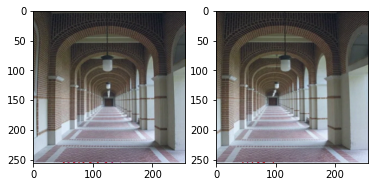

Step 100, Total loss 0.000158


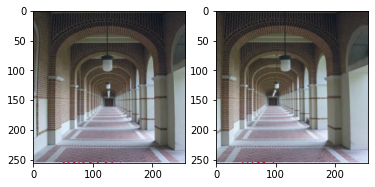

Step 200, Total loss 0.000135


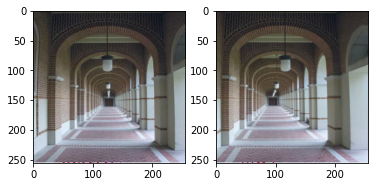

Step 300, Total loss 0.000121


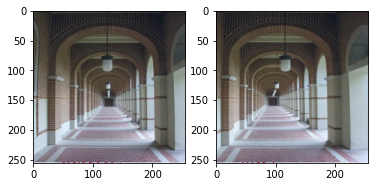

Step 400, Total loss 0.000112


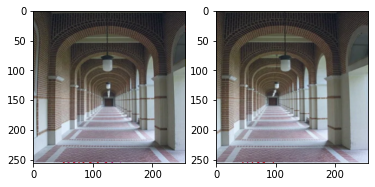

Step 500, Total loss 0.000100


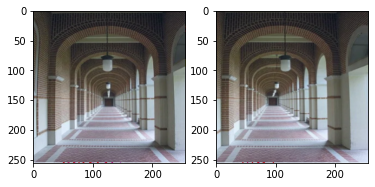

Step 600, Total loss 0.000096


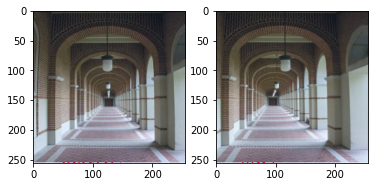

Step 700, Total loss 0.000094


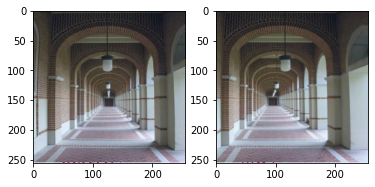

Step 800, Total loss 0.000088


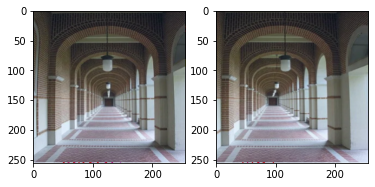

Step 900, Total loss 0.000085


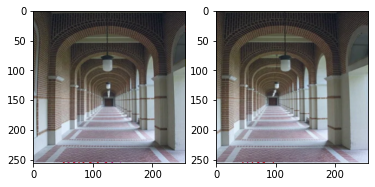

In [58]:
total_steps = 1000 # Since the whole image is our dataset, this just means 500 gradient descent steps.
steps_til_summary = 100

optim = torch.optim.Adam(lr=1e-5, params=img_siren.parameters())
# optim = torch.optim.SGD(lr=1e-4, momentum=0.9, params=img_siren.parameters())
# optim = torch.optim.Rprop(params = img_siren.parameters())

model_input, ground_truth = next(iter(dataloader))
model_input, ground_truth = model_input.cuda(), ground_truth.cuda()

def mu(x):
    x -= x.min()
    x /= x.max()
    return x

for step in range(total_steps):
    model_output, coords = img_siren(model_input)    
    loss = ((model_output - ground_truth)**2).mean()
    
    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))
        #img_grad = gradient(model_output, coords)
        #img_laplacian = laplace(model_output, coords)

        normalized_output = mu(model_output).view(2, 256,256, 3)
        left = normalized_output[0,:,:,:]
        right = normalized_output[1,:,:,:]

        fig, (l, r) = plt.subplots(1, 2)
        l.imshow(left.cpu().detach().numpy())
        r.imshow(right.cpu().detach().numpy())
        plt.show()

    optim.zero_grad()
    loss.backward()
    optim.step()

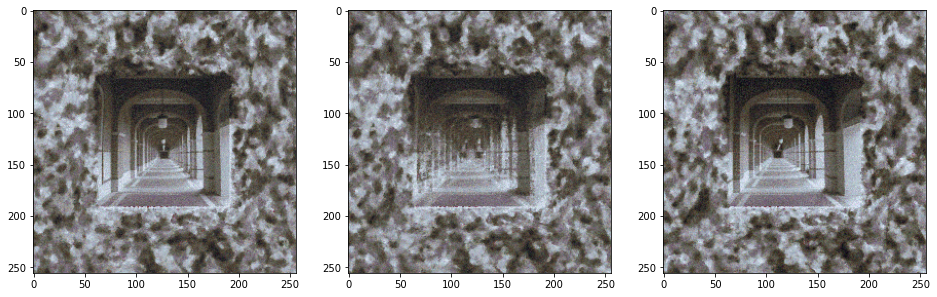

In [59]:
with torch.no_grad():
    out_of_range_coords = get_mgrid(256, 2) * 2
    left_mask = torch.full((256*256, 1), LEFT_MASK)
    right_mask = torch.full((256*256, 1), RIGHT_MASK)
    center_mask = torch.full((256*256, 1), 0)

    left_coords = torch.cat((left_mask, out_of_range_coords), 1)
    right_coords = torch.cat((right_mask, out_of_range_coords), 1)
    center_coords = torch.cat((center_mask, out_of_range_coords), 1)

    left, _ = img_siren(left_coords.cuda())
    right, _ = img_siren(right_coords.cuda())
    center, _ = img_siren(center_coords.cuda())
    
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(16,16))
    ax1.imshow(mu(left).cpu().view(256,256, 3).numpy())
    ax2.imshow(mu(center).cpu().view(256,256, 3).numpy())
    ax3.imshow(mu(right).cpu().view(256,256, 3).numpy())
    plt.show()

Though there is some self-similarity, the signal is not repeated on this range of (-50, 50).

## Fitting an audio signal
<a id='section_2'></a>

Here, we'll use Siren to parameterize an audio signal - i.e., we seek to parameterize an audio waverform $f(t)$  at time points $t$ by a SIREN $\Phi$.

That is we seek the function $\Phi$ such that:  $\mathcal{L}\int_\Omega \lVert \Phi(t) - f(t) \rVert \mathrm{d}t$  is minimized, in which  $\Omega$  is the domain of the waveform.

For the audio, we'll use the bach sonata:

In [ ]:
import scipy.io.wavfile as wavfile
import io
from IPython.display import Audio

if not os.path.exists('gt_bach.wav'):
    !wget https://vsitzmann.github.io/siren/img/audio/gt_bach.wav

--2021-01-18 21:11:31--  https://vsitzmann.github.io/siren/img/audio/gt_bach.wav
Resolving vsitzmann.github.io (vsitzmann.github.io)... 185.199.108.153, 185.199.109.153, 185.199.110.153, ...
Connecting to vsitzmann.github.io (vsitzmann.github.io)|185.199.108.153|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1232886 (1.2M) [audio/wav]
Saving to: ‘gt_bach.wav’

gt_bach.wav         100%[===================>]   1.17M  --.-KB/s    in 0.06s   

2021-01-18 21:11:31 (21.0 MB/s) - ‘gt_bach.wav’ saved [1232886/1232886]



Let's build a little dataset that computes coordinates for audio files:

In [ ]:
class AudioFile(torch.utils.data.Dataset):
    def __init__(self, filename):
        self.rate, self.data = wavfile.read(filename)
        self.data = self.data.astype(np.float32)
        self.timepoints = get_mgrid(len(self.data), 1)

    def get_num_samples(self):
        return self.timepoints.shape[0]

    def __len__(self):
        return 1

    def __getitem__(self, idx):
        amplitude = self.data
        scale = np.max(np.abs(amplitude))
        amplitude = (amplitude / scale)
        amplitude = torch.Tensor(amplitude).view(-1, 1)
        return self.timepoints, amplitude

Let's instantiate the Siren. As this audio signal has a much higer spatial frequency on the range of -1 to 1, we increase the $\omega_0$ in the first layer of siren.

In [ ]:
bach_audio = AudioFile('gt_bach.wav')

dataloader = DataLoader(bach_audio, shuffle=True, batch_size=1, pin_memory=True, num_workers=0)

# Note that we increase the frequency of the first layer to match the higher frequencies of the
# audio signal. Equivalently, we could also increase the range of the input coordinates.
audio_siren = Siren(in_features=1, out_features=1, hidden_features=256, 
                    hidden_layers=3, first_omega_0=3000, outermost_linear=True)
audio_siren.cuda()

Siren(
  (net): Sequential(
    (0): SineLayer(
      (linear): Linear(in_features=1, out_features=256, bias=True)
    )
    (1): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (2): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (3): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (4): Linear(in_features=256, out_features=1, bias=True)
  )
)

Let's have a quick listen to ground truth:

In [ ]:
rate, _ = wavfile.read('gt_bach.wav')

model_input, ground_truth = next(iter(dataloader))
Audio(ground_truth.squeeze().numpy(),rate=rate)

We now fit the Siren to this signal.

Step 0, Total loss 0.024715


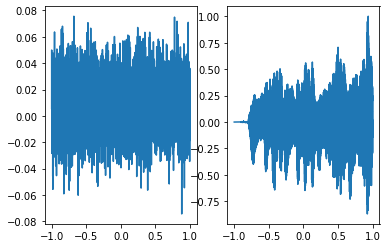

Step 100, Total loss 0.002825


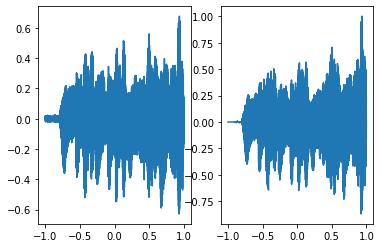

Step 200, Total loss 0.001092


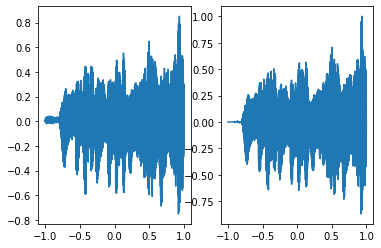

Step 300, Total loss 0.000797


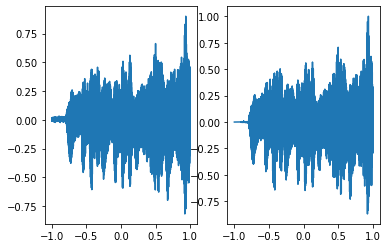

Step 400, Total loss 0.000640


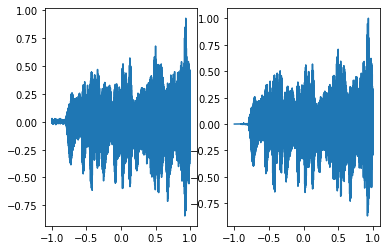

Step 500, Total loss 0.000731


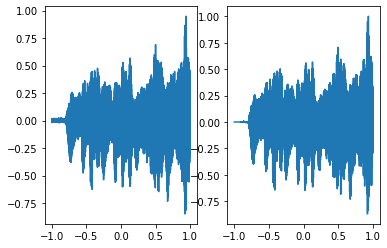

Step 600, Total loss 0.000382


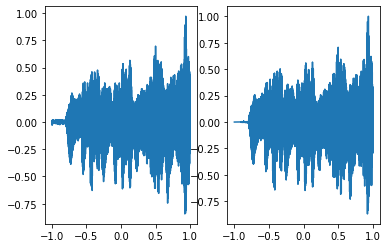

Step 700, Total loss 0.000269


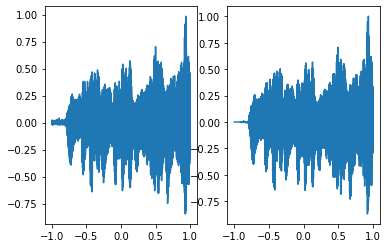

Step 800, Total loss 0.000212


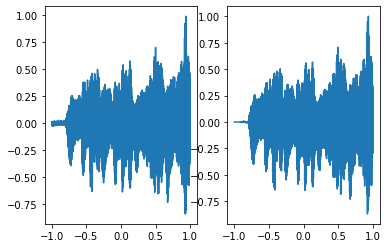

Step 900, Total loss 0.000249


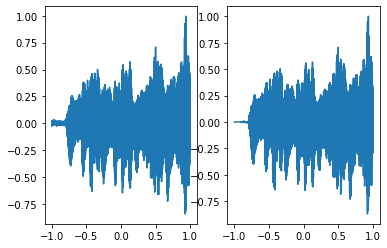

In [ ]:
total_steps = 1000 
steps_til_summary = 100

optim = torch.optim.Adam(lr=1e-4, params=audio_siren.parameters())

model_input, ground_truth = next(iter(dataloader))
model_input, ground_truth = model_input.cuda(), ground_truth.cuda()

for step in range(total_steps):
    model_output, coords = audio_siren(model_input)    
    loss = F.mse_loss(model_output, ground_truth)
    
    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))
    
        fig, axes = plt.subplots(1,2)
        axes[0].plot(coords.squeeze().detach().cpu().numpy(),model_output.squeeze().detach().cpu().numpy())
        axes[1].plot(coords.squeeze().detach().cpu().numpy(),ground_truth.squeeze().detach().cpu().numpy())
        plt.show()

    optim.zero_grad()
    loss.backward()
    optim.step()

In [ ]:
final_model_output, coords = audio_siren(model_input)
Audio(final_model_output.cpu().detach().squeeze().numpy(),rate=rate)

As we can see, within few iterations, Siren has approximated the audio signal very well!

<a id='section_3'></a>
## Solving Poisson's equation

Now, let's make it a bit harder. Let's say we want to reconstruct an image but we only have access to its gradients!

That is, we now seek the function $\Phi$ such that:
$\mathcal{L}=\int_{\Omega} \lVert \nabla\Phi(\mathbf{x}) - \nabla f(\mathbf{x}) \rVert\mathrm{d}\mathbf{x}$
 is minimized, in which $\Omega$ is the domain of the image. 

In [ ]:
import scipy.ndimage
    
class PoissonEqn(Dataset):
    def __init__(self, sidelength):
        super().__init__()
        img = get_cameraman_tensor(sidelength)
        
        # Compute gradient and laplacian       
        grads_x = scipy.ndimage.sobel(img.numpy(), axis=1).squeeze(0)[..., None]
        grads_y = scipy.ndimage.sobel(img.numpy(), axis=2).squeeze(0)[..., None]
        grads_x, grads_y = torch.from_numpy(grads_x), torch.from_numpy(grads_y)
                
        self.grads = torch.stack((grads_x, grads_y), dim=-1).view(-1, 2)
        self.laplace = scipy.ndimage.laplace(img.numpy()).squeeze(0)[..., None]
        self.laplace = torch.from_numpy(self.laplace)
        
        self.pixels = img.permute(1, 2, 0).view(-1, 1)
        self.coords = get_mgrid(sidelength, 2)

    def __len__(self):
        return 1

    def __getitem__(self, idx):
        return self.coords, {'pixels':self.pixels, 'grads':self.grads, 'laplace':self.laplace}

#### Instantiate SIREN model

In [ ]:
cameraman_poisson = PoissonEqn(128)
dataloader = DataLoader(cameraman_poisson, batch_size=1, pin_memory=True, num_workers=0)

poisson_siren = Siren(in_features=2, out_features=1, hidden_features=256, 
                      hidden_layers=3, outermost_linear=True)
poisson_siren.cuda()

Siren(
  (net): Sequential(
    (0): SineLayer(
      (linear): Linear(in_features=2, out_features=256, bias=True)
    )
    (1): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (2): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (3): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (4): Linear(in_features=256, out_features=1, bias=True)
  )
)

#### Define the loss function

In [ ]:
def gradients_mse(model_output, coords, gt_gradients):
    # compute gradients on the model
    gradients = gradient(model_output, coords)
    # compare them with the ground-truth
    gradients_loss = torch.mean((gradients - gt_gradients).pow(2).sum(-1))
    return gradients_loss

#### Train the model

Step 0, Total loss 21.826477, iteration time 0.004580


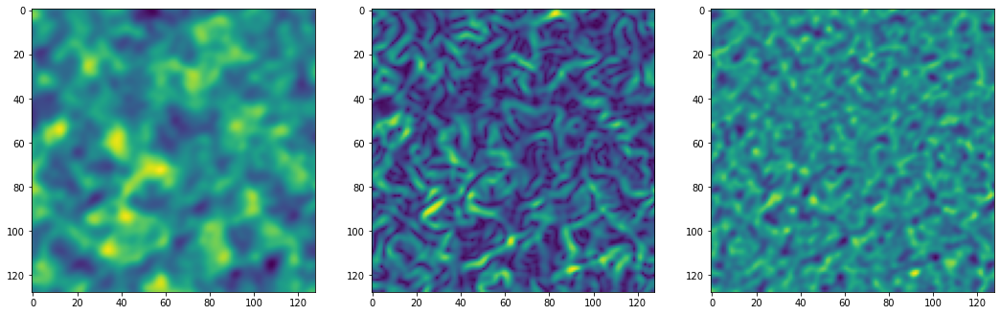

Step 10, Total loss 6.484425, iteration time 0.002447


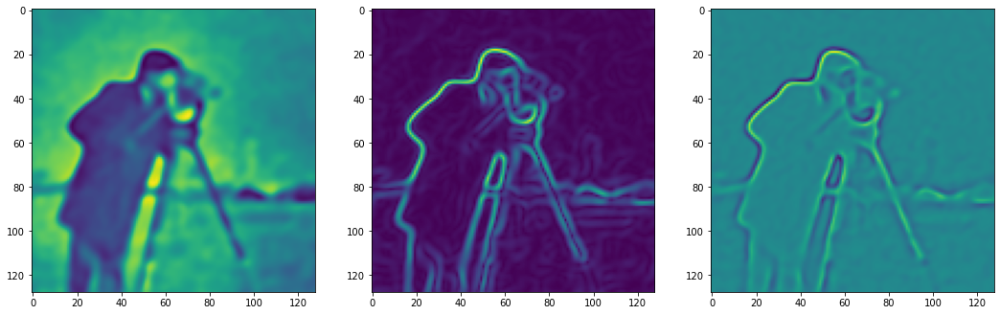

Step 20, Total loss 2.415866, iteration time 0.002495


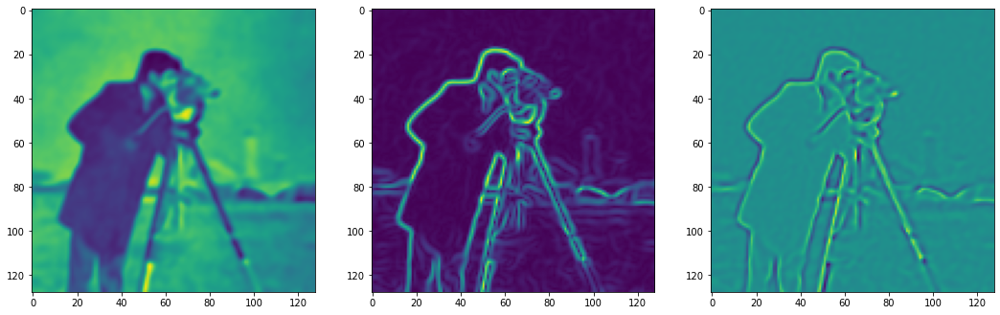

Step 30, Total loss 0.842566, iteration time 0.002218


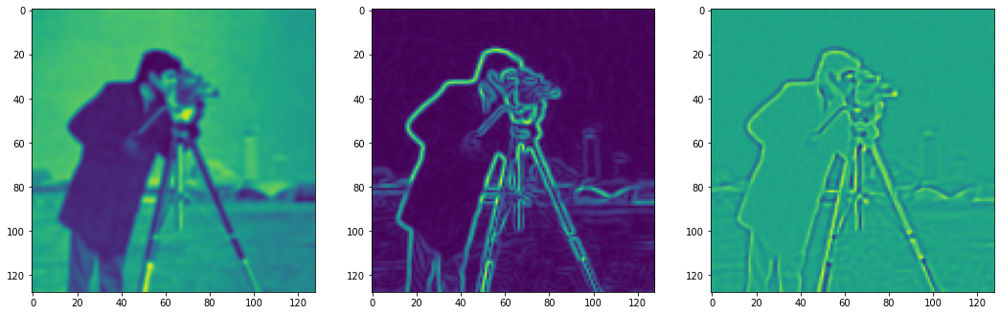

Step 40, Total loss 0.419692, iteration time 0.003470


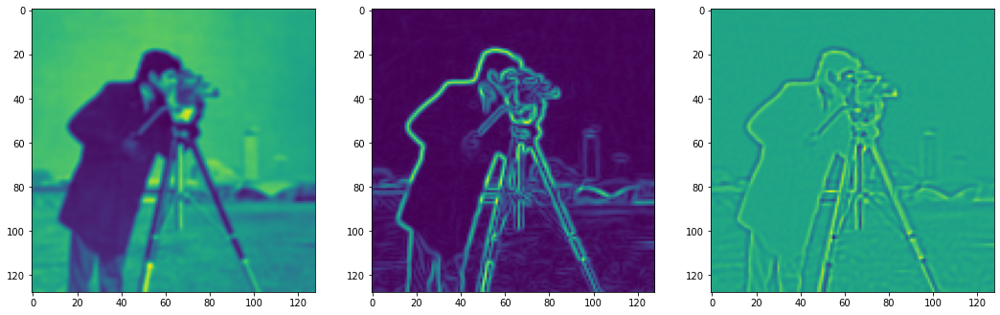

Step 50, Total loss 0.258621, iteration time 0.002687


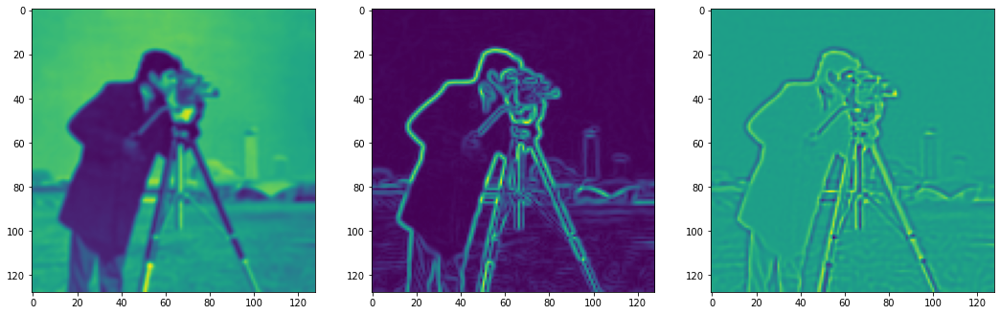

Step 60, Total loss 0.169160, iteration time 0.001946


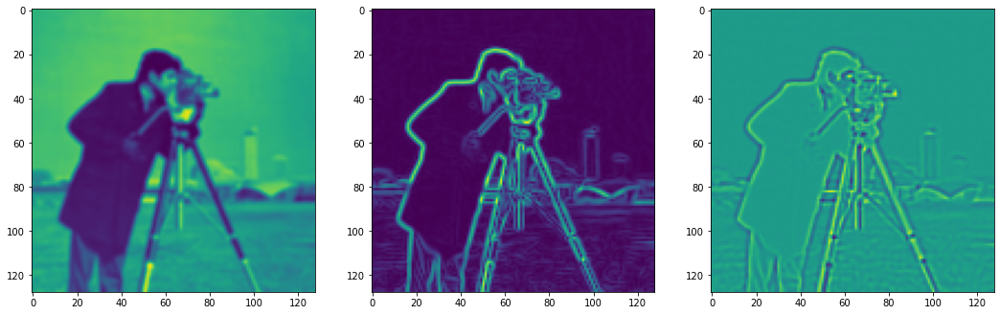

Step 70, Total loss 0.114919, iteration time 0.001965


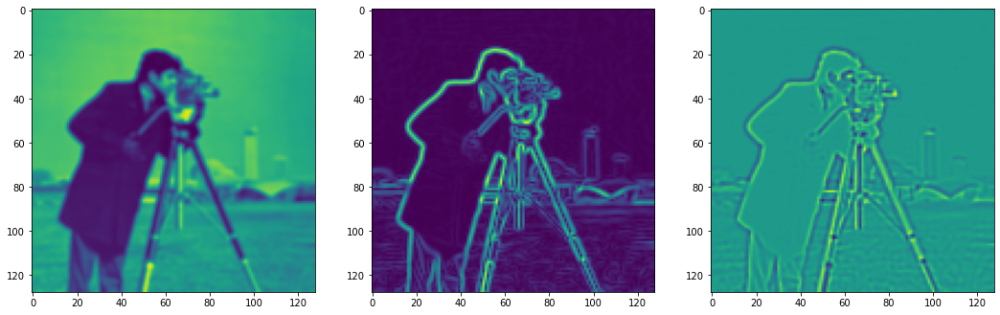

Step 80, Total loss 0.087134, iteration time 0.001860


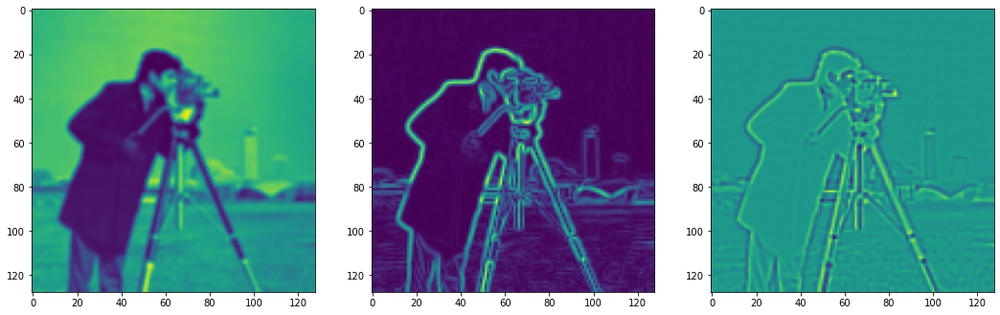

Step 90, Total loss 0.070548, iteration time 0.002023


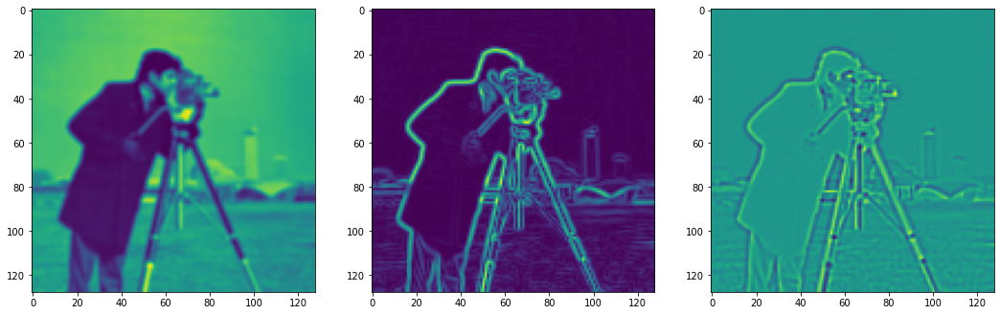

Step 100, Total loss 0.059051, iteration time 0.001895


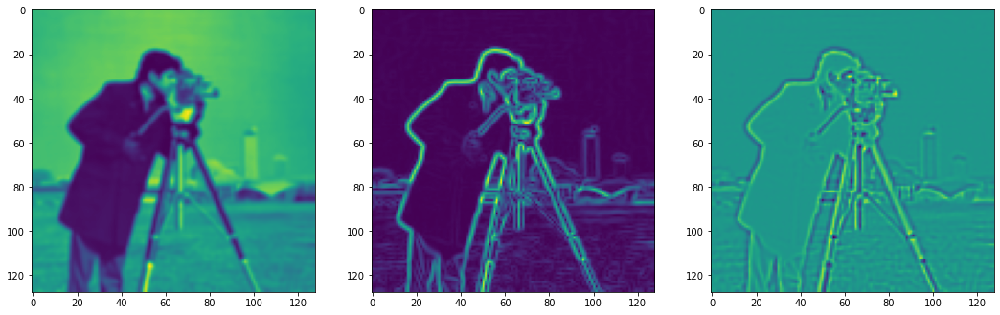

Step 110, Total loss 0.100904, iteration time 0.001987


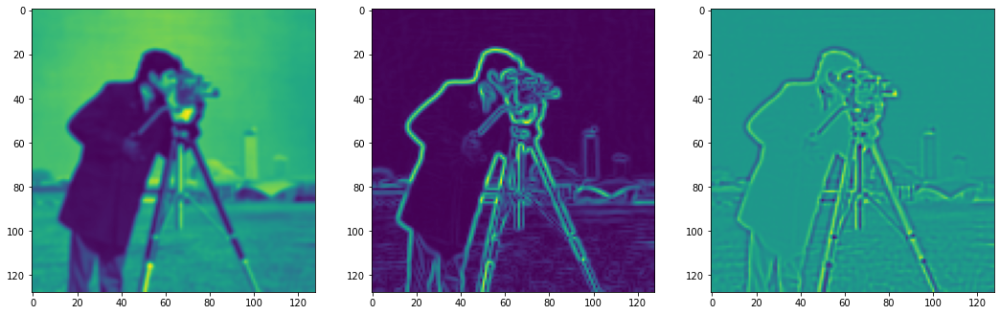

Step 120, Total loss 0.048690, iteration time 0.001959


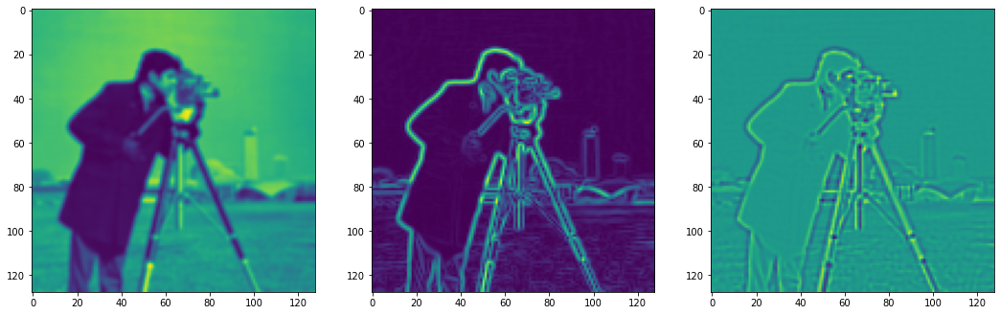

Step 130, Total loss 0.042554, iteration time 0.002129


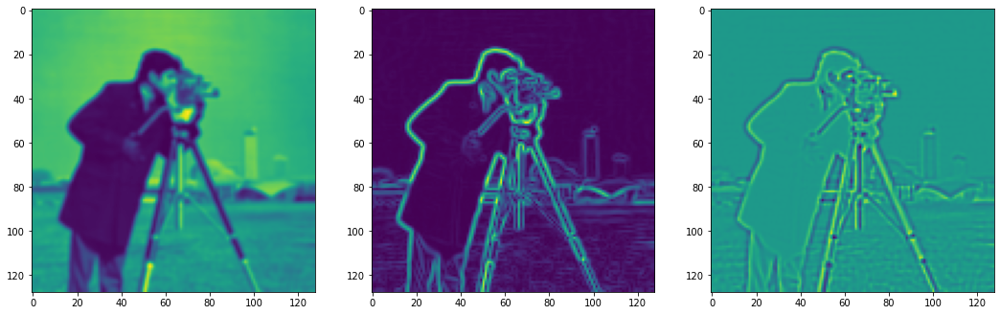

Step 140, Total loss 0.039369, iteration time 0.001847


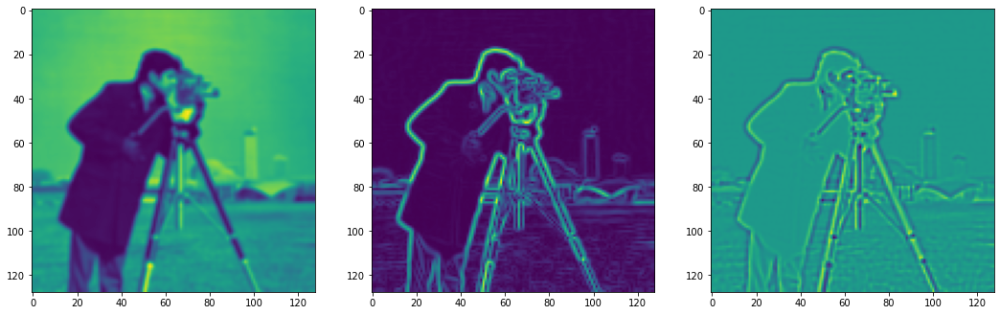

Step 150, Total loss 0.035895, iteration time 0.001913


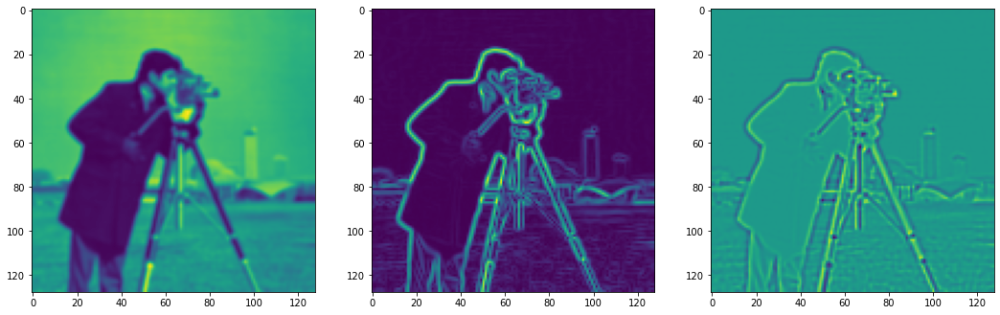

Step 160, Total loss 0.033248, iteration time 0.001849


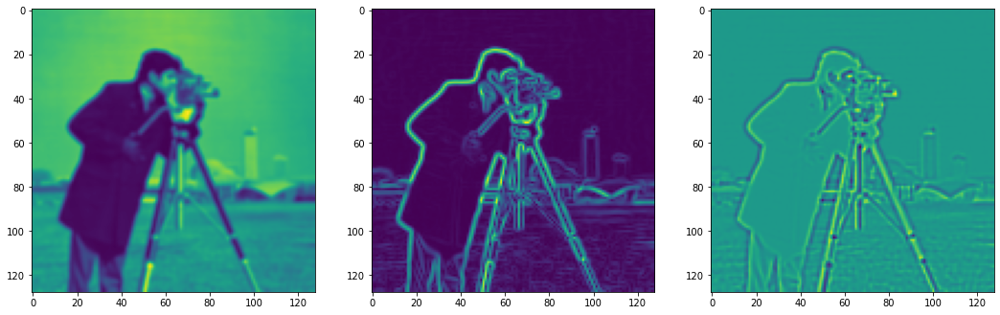

Step 170, Total loss 0.062109, iteration time 0.002096


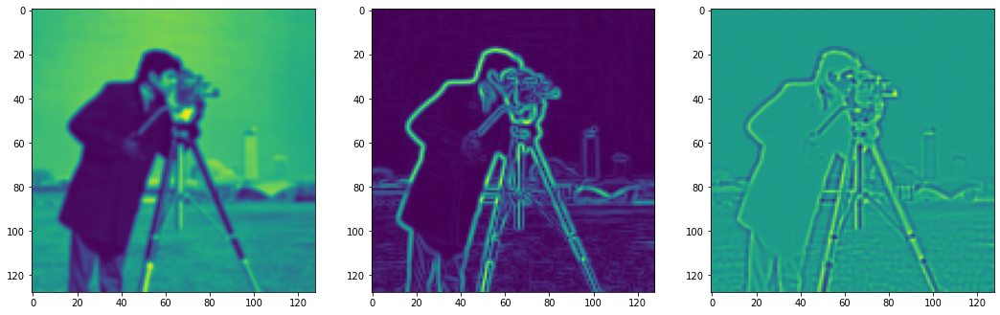

Step 180, Total loss 0.034571, iteration time 0.002935


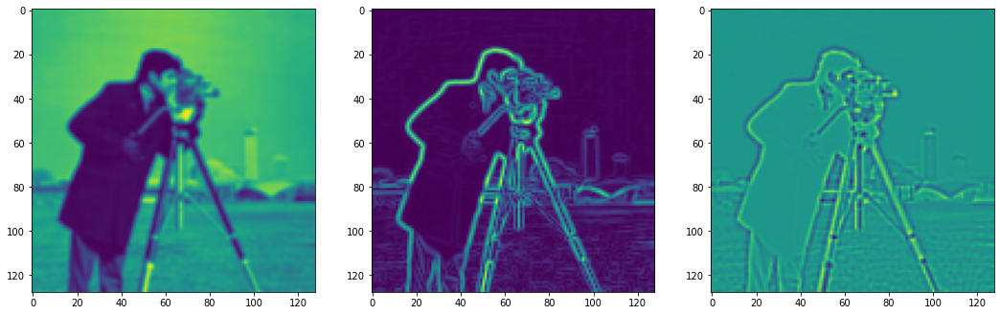

Step 190, Total loss 0.029623, iteration time 0.002677


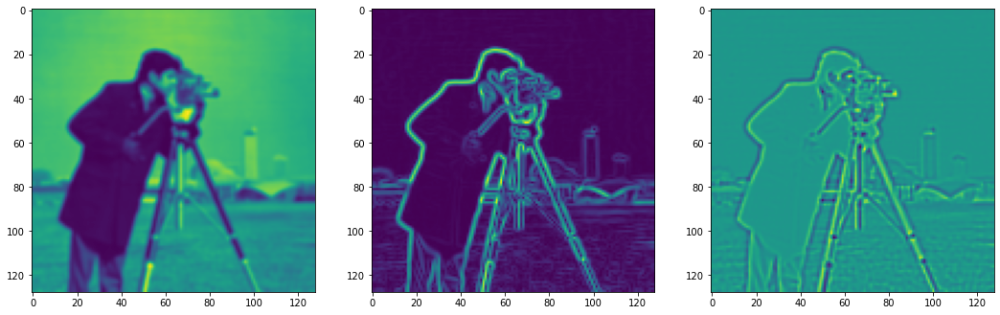

Step 200, Total loss 0.027588, iteration time 0.002149


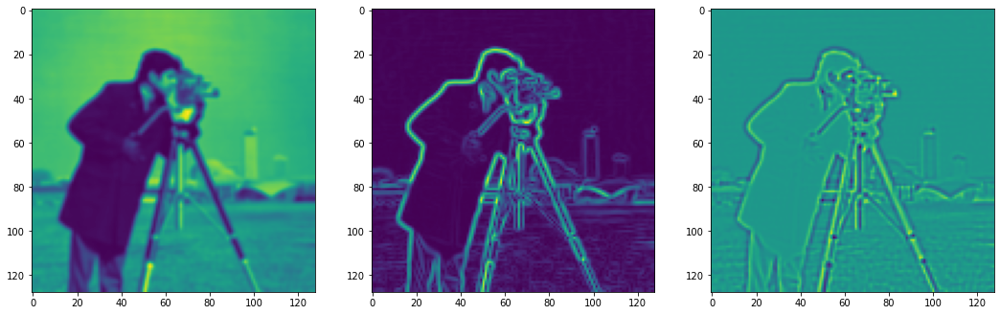

Step 210, Total loss 0.055395, iteration time 0.002200


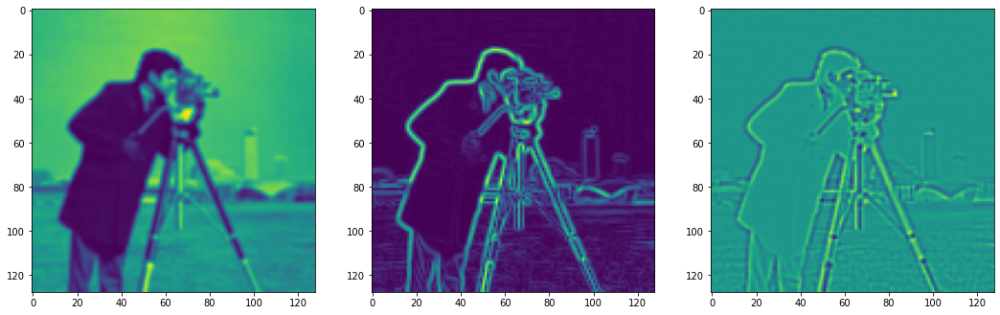

Step 220, Total loss 0.030084, iteration time 0.002052


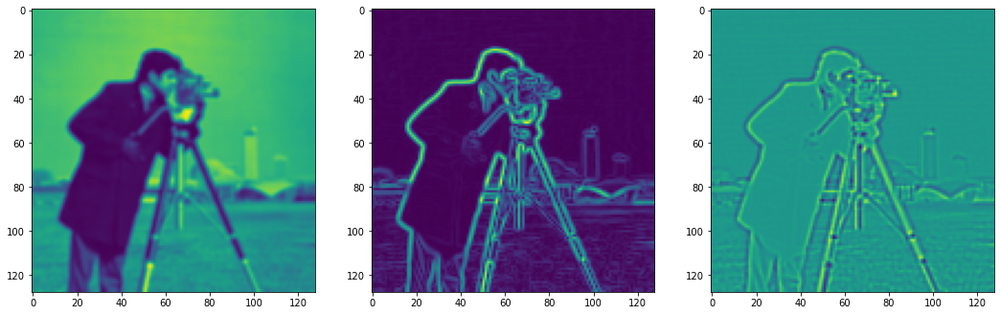

Step 230, Total loss 0.025866, iteration time 0.002170


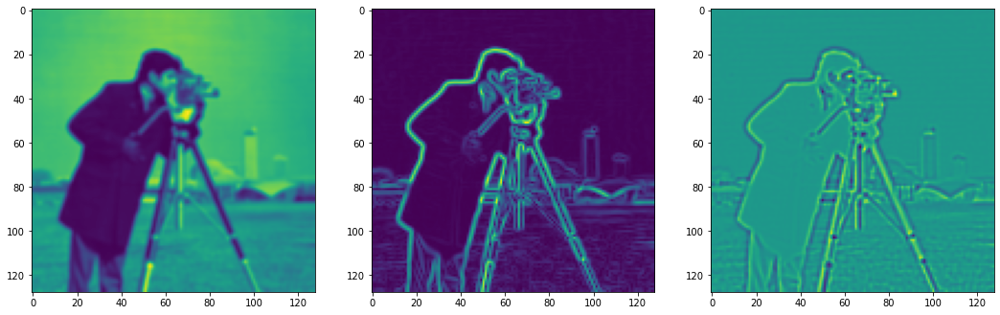

Step 240, Total loss 0.024434, iteration time 0.001896


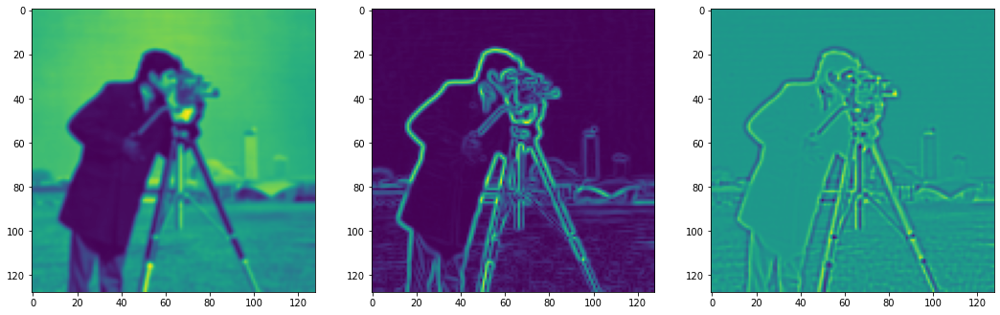

Step 250, Total loss 0.027724, iteration time 0.001901


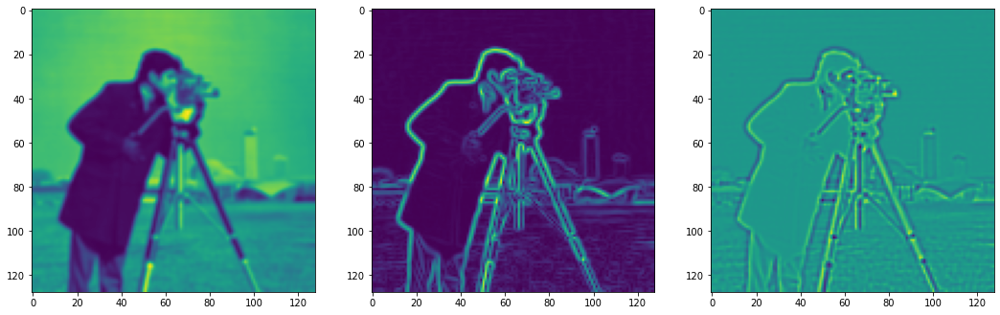

Step 260, Total loss 0.028222, iteration time 0.001990


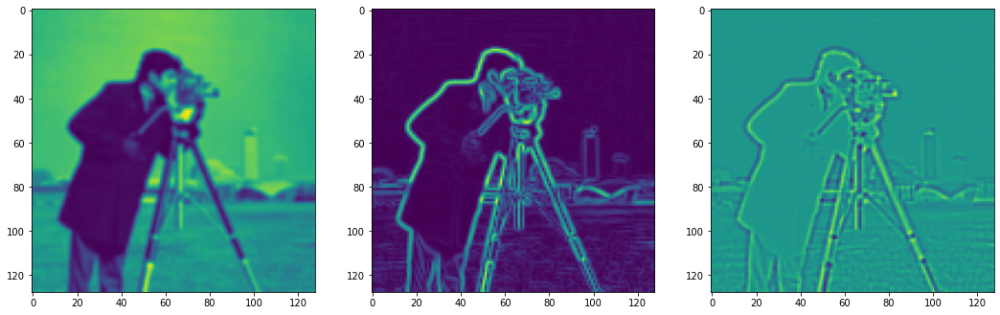

Step 270, Total loss 0.032038, iteration time 0.002149


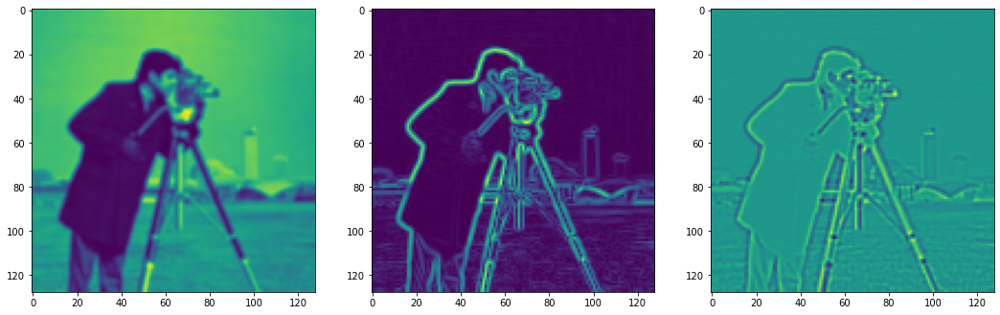

Step 280, Total loss 0.026398, iteration time 0.003451


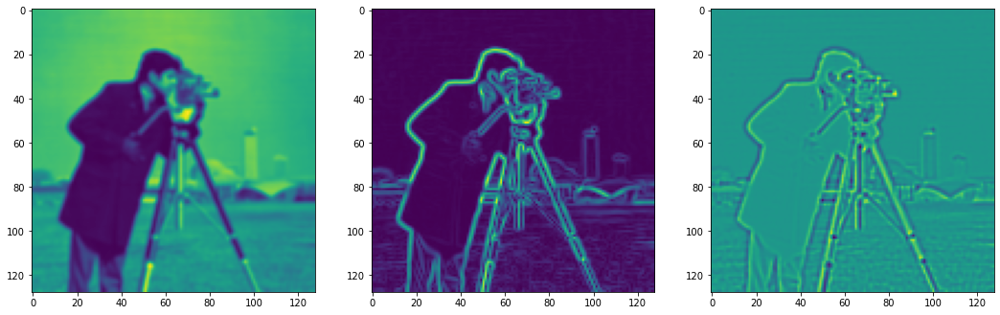

Step 290, Total loss 0.022447, iteration time 0.001980


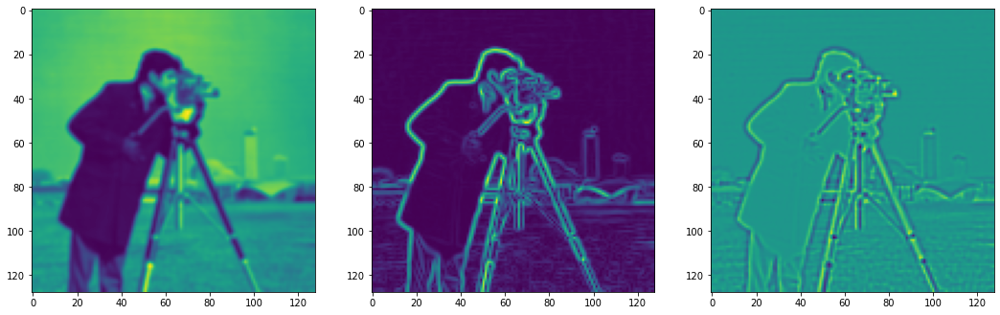

Step 300, Total loss 0.020878, iteration time 0.001934


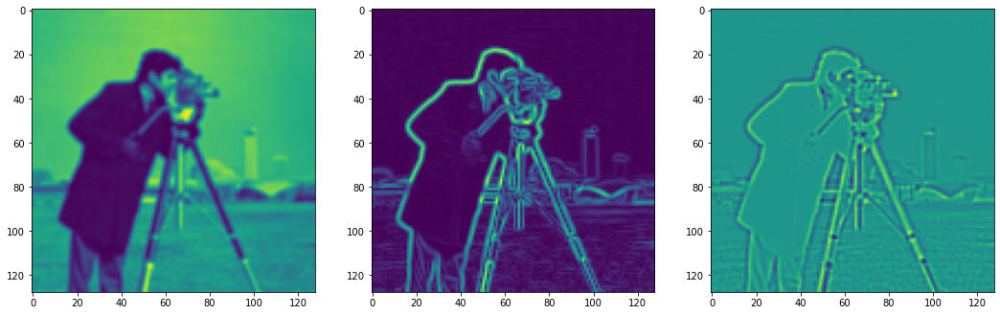

Step 310, Total loss 0.019884, iteration time 0.003099


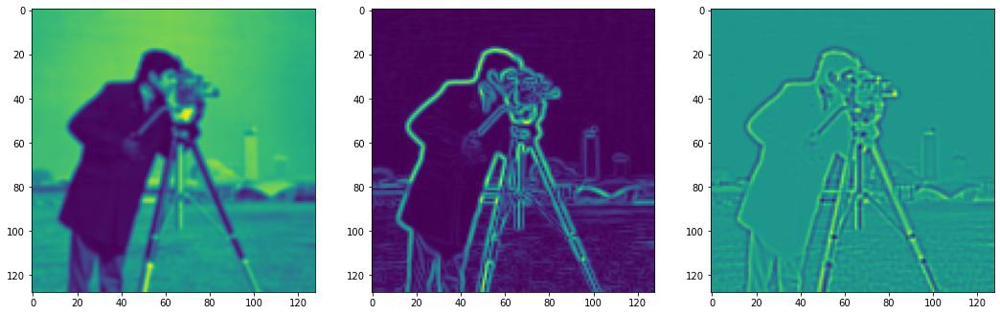

Step 320, Total loss 0.019458, iteration time 0.001991


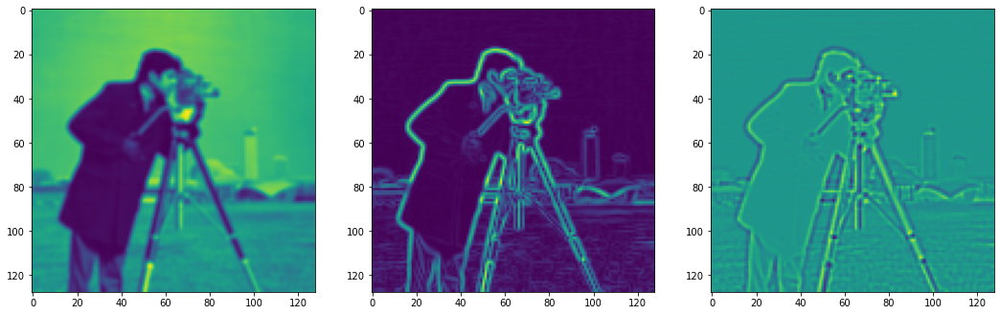

Step 330, Total loss 0.019077, iteration time 0.001888


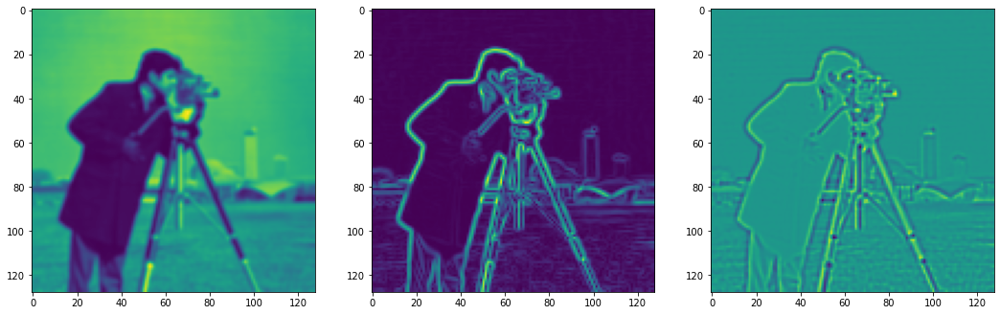

Step 340, Total loss 0.018725, iteration time 0.002141


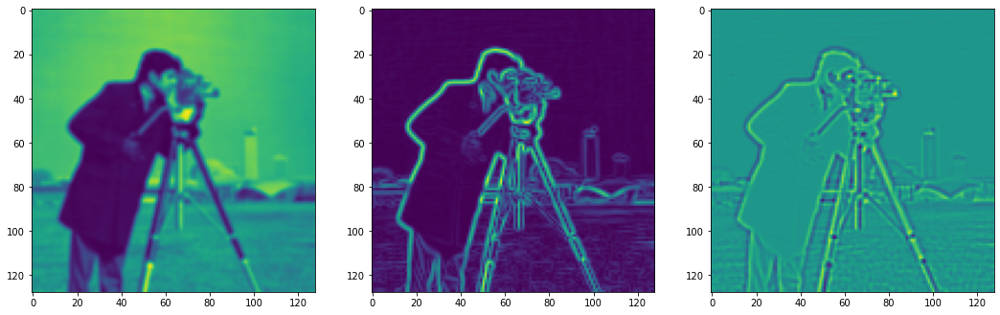

Step 350, Total loss 0.018486, iteration time 0.001990


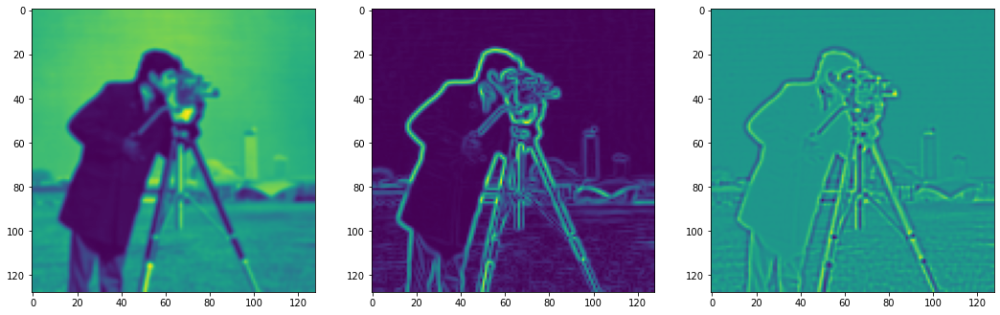

Step 360, Total loss 0.043065, iteration time 0.001937


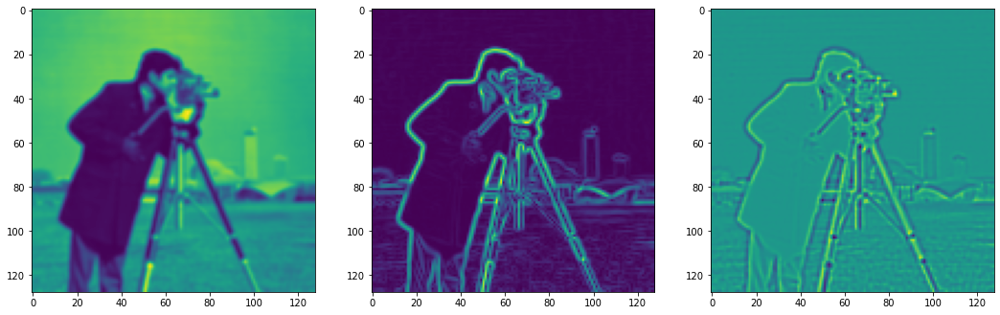

Step 370, Total loss 0.027584, iteration time 0.001936


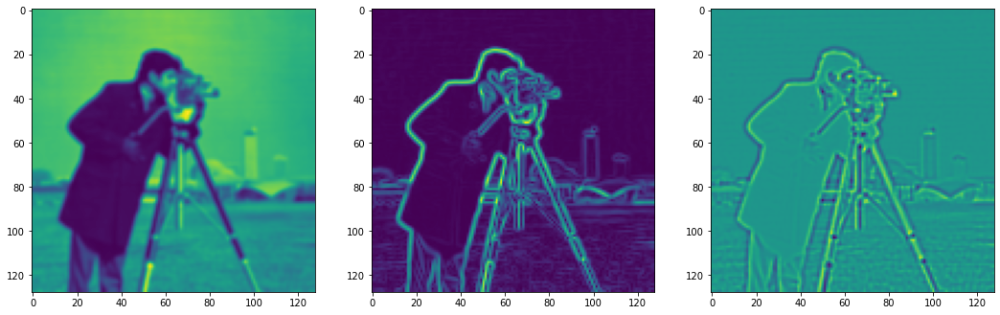

Step 380, Total loss 0.021634, iteration time 0.001950


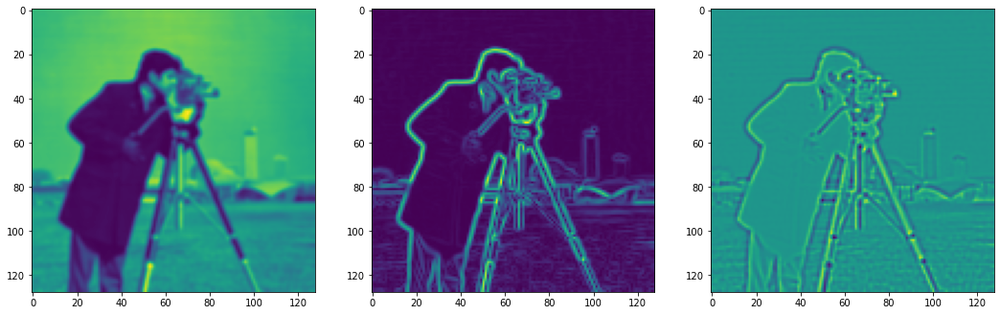

Step 390, Total loss 0.018311, iteration time 0.002350


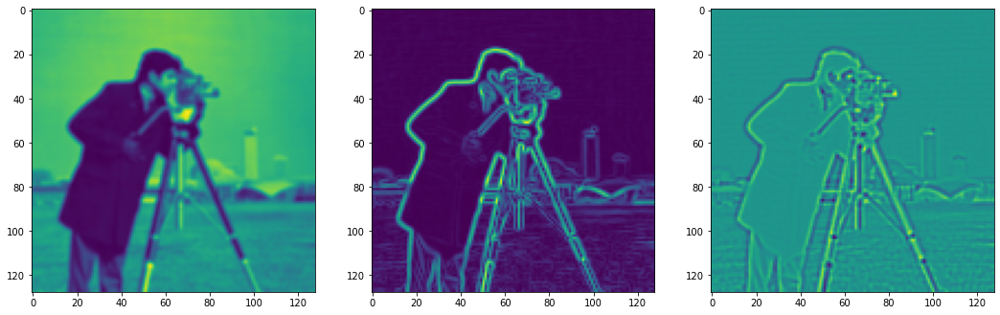

Step 400, Total loss 0.017525, iteration time 0.002532


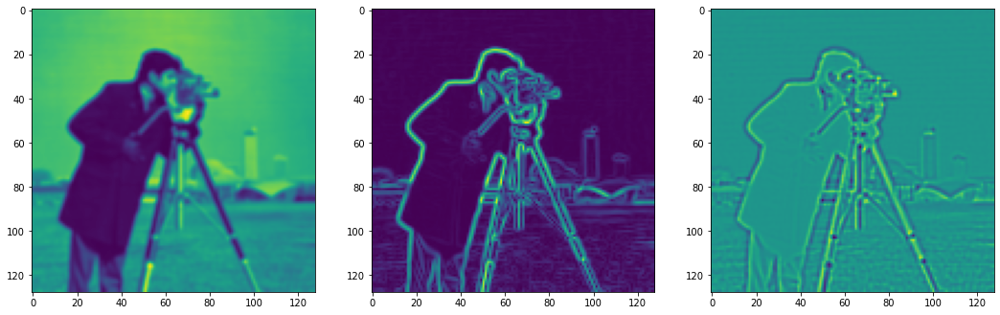

Step 410, Total loss 0.016902, iteration time 0.001984


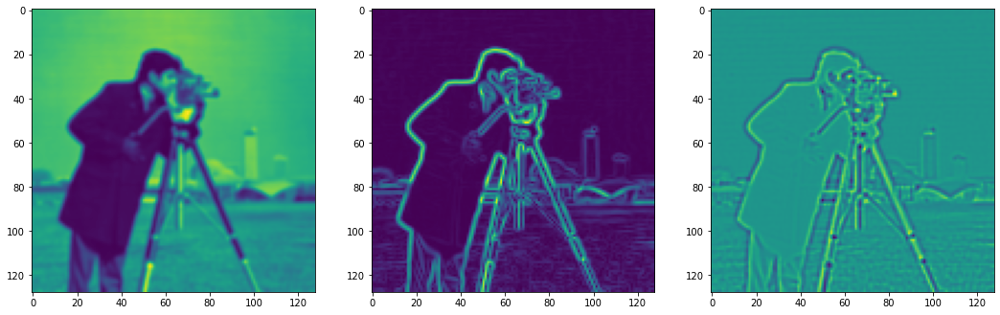

Step 420, Total loss 0.016541, iteration time 0.001936


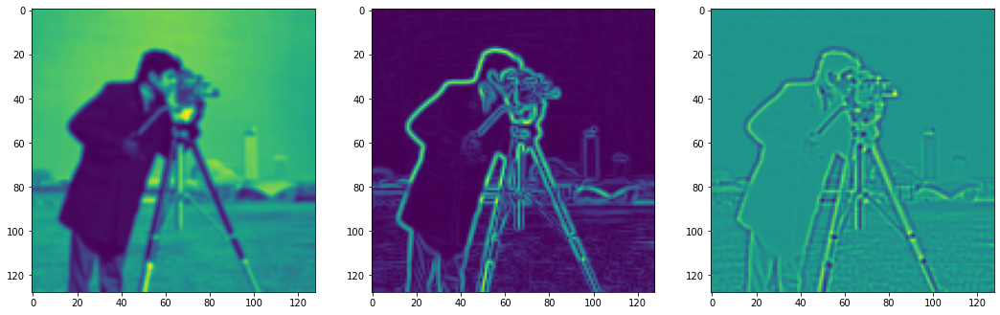

Step 430, Total loss 0.016222, iteration time 0.002159


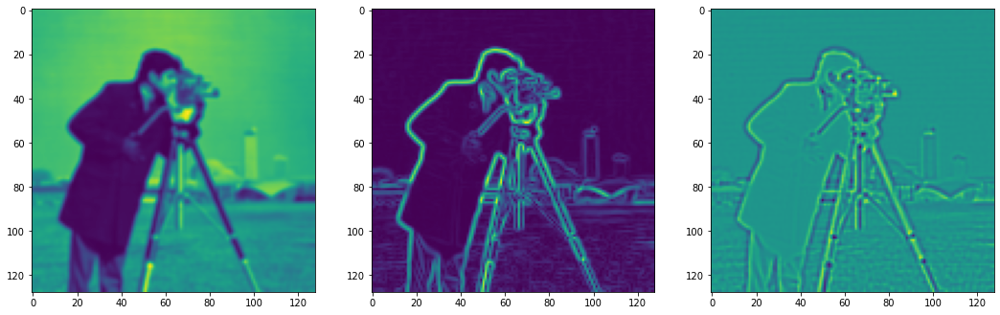

Step 440, Total loss 0.015943, iteration time 0.001928


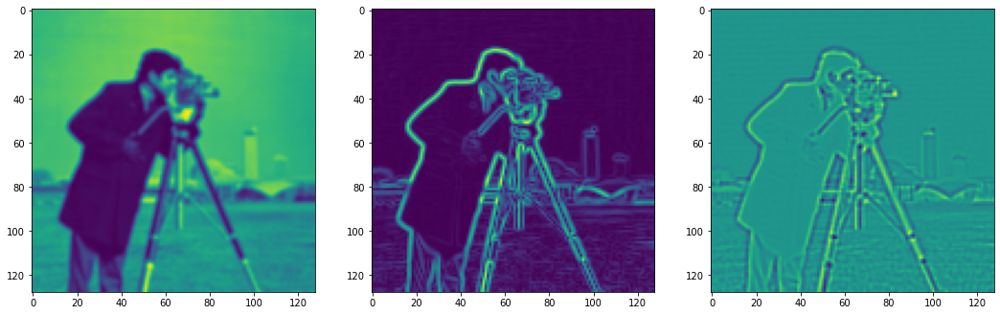

Step 450, Total loss 0.015842, iteration time 0.002730


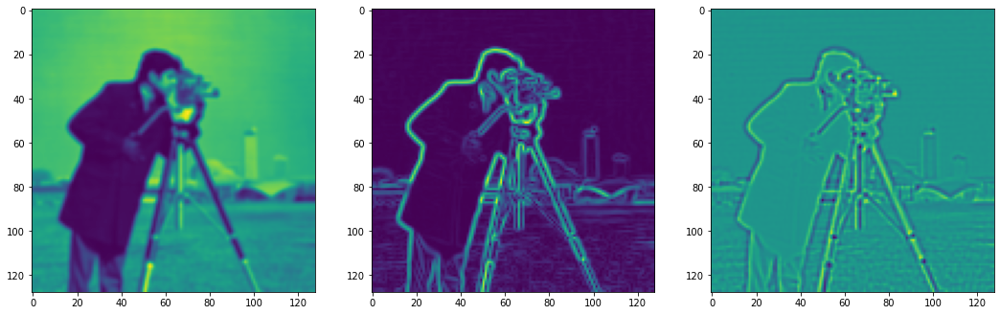

Step 460, Total loss 0.046166, iteration time 0.001913


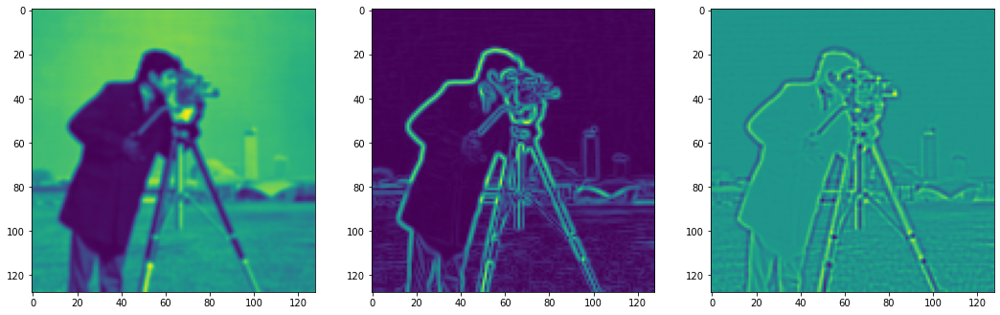

Step 470, Total loss 0.023244, iteration time 0.001945


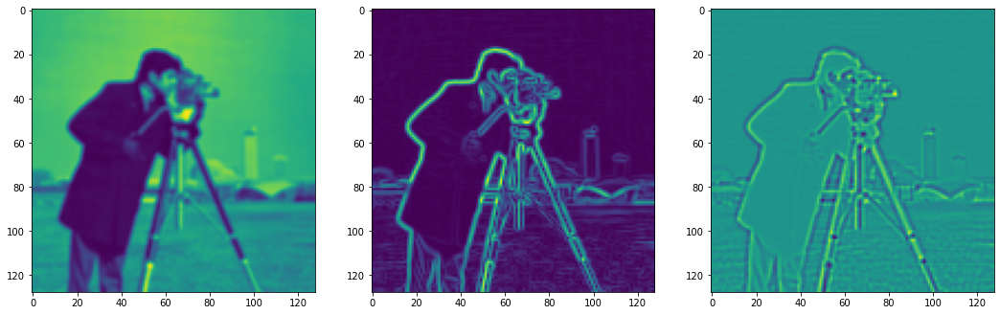

Step 480, Total loss 0.019451, iteration time 0.004147


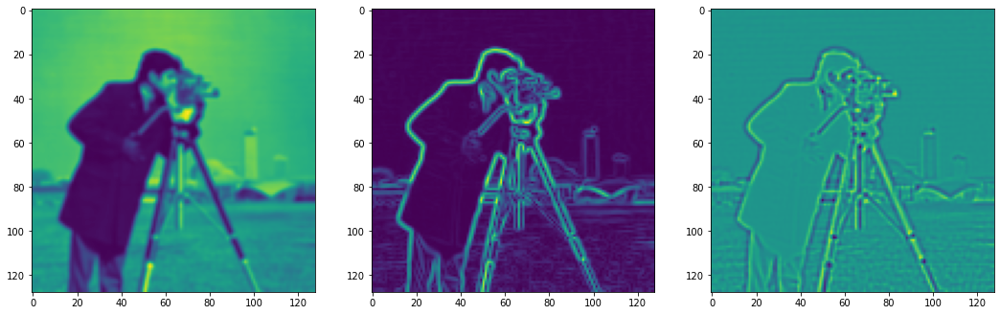

Step 490, Total loss 0.015805, iteration time 0.001884


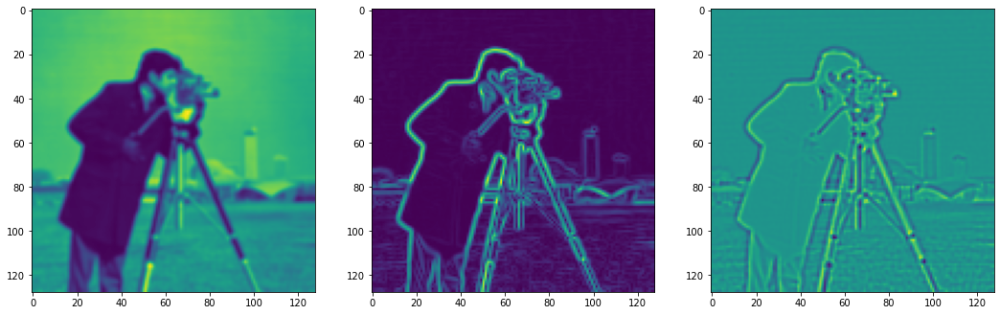

Step 500, Total loss 0.015040, iteration time 0.001958


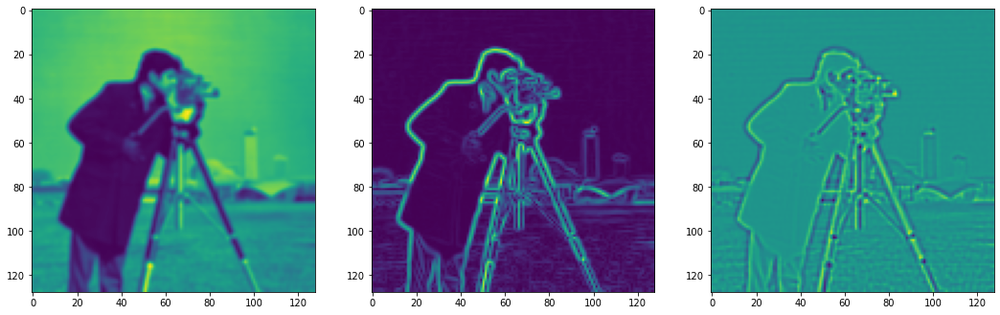

Step 510, Total loss 0.014509, iteration time 0.001868


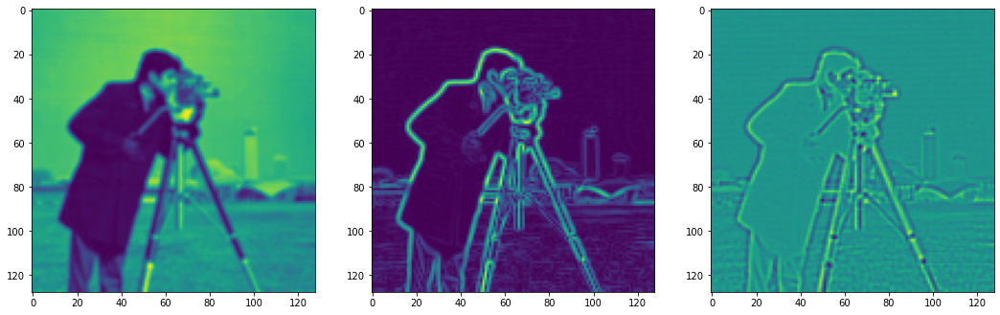

Step 520, Total loss 0.014178, iteration time 0.002207


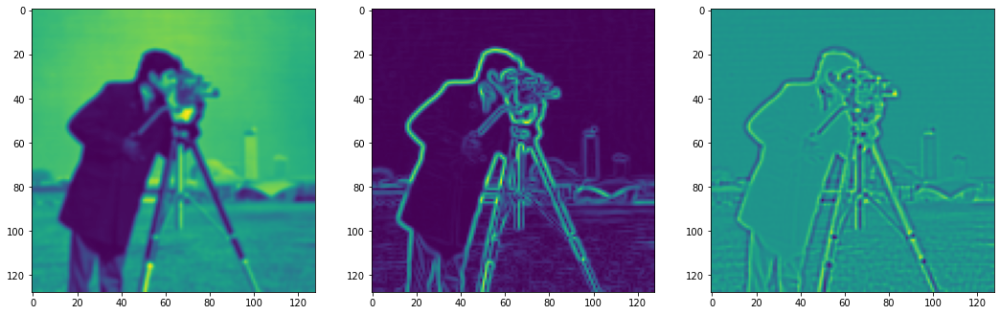

Step 530, Total loss 0.013940, iteration time 0.002452


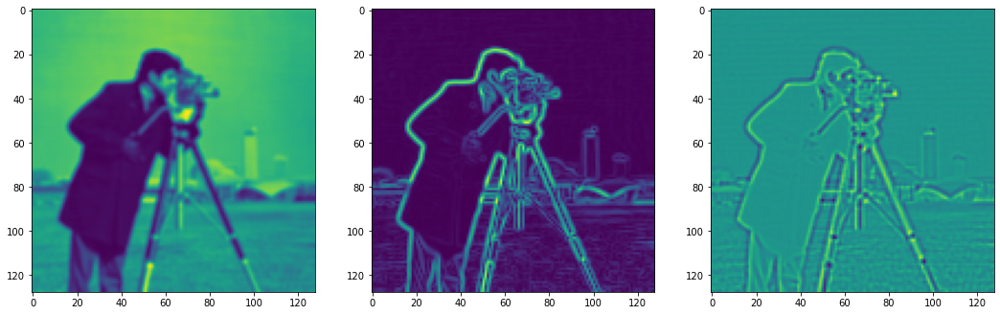

Step 540, Total loss 0.013716, iteration time 0.001889


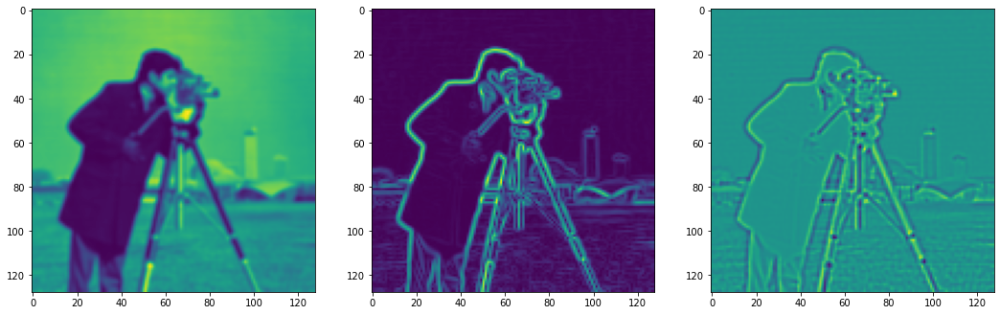

Step 550, Total loss 0.013513, iteration time 0.001970


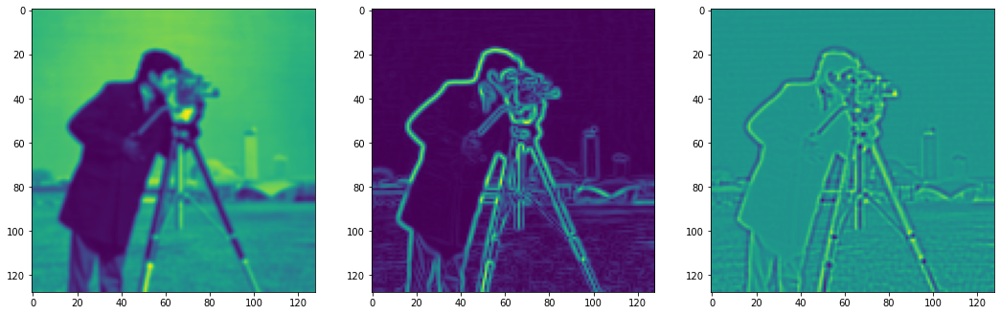

Step 560, Total loss 0.013443, iteration time 0.001908


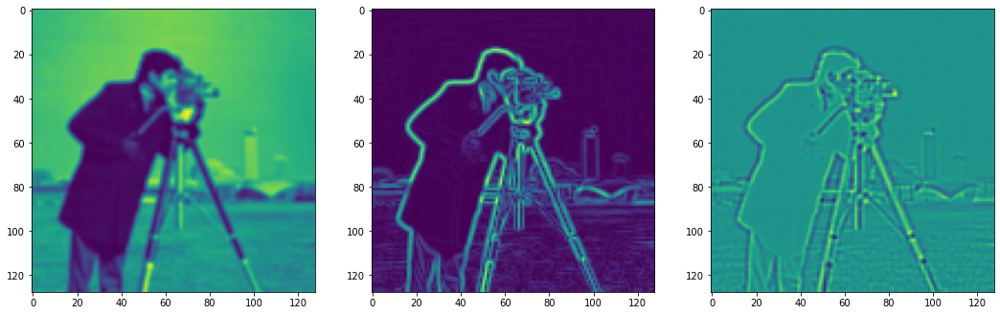

Step 570, Total loss 0.038889, iteration time 0.001961


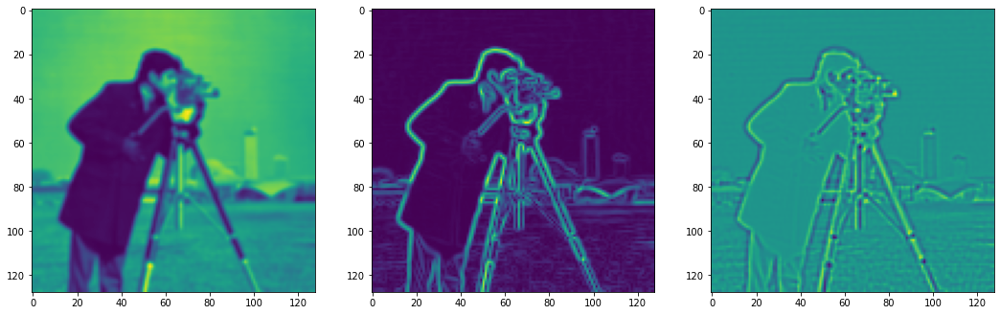

Step 580, Total loss 0.016279, iteration time 0.001904


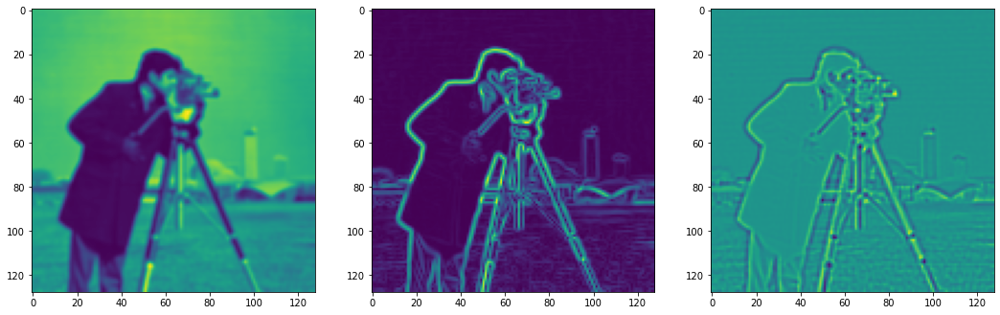

Step 590, Total loss 0.014242, iteration time 0.002460


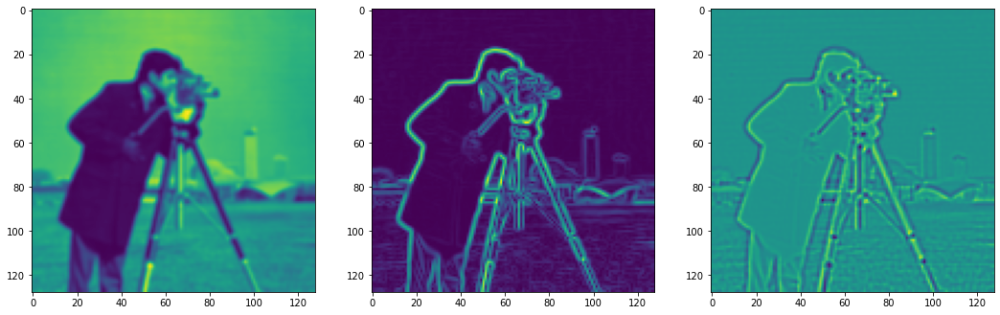

Step 600, Total loss 0.013016, iteration time 0.001934


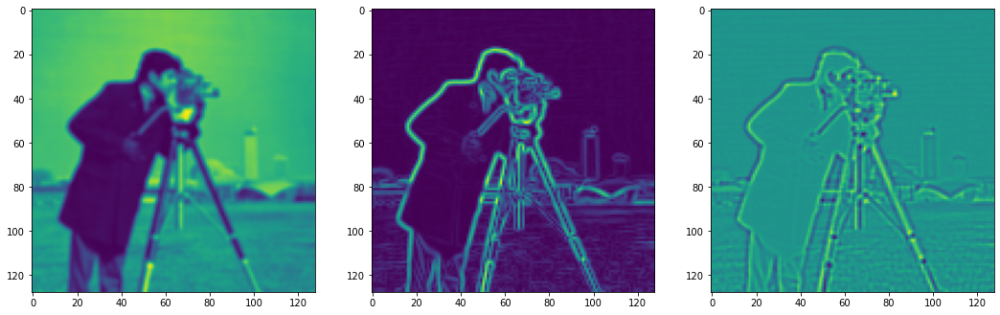

Step 610, Total loss 0.012543, iteration time 0.001894


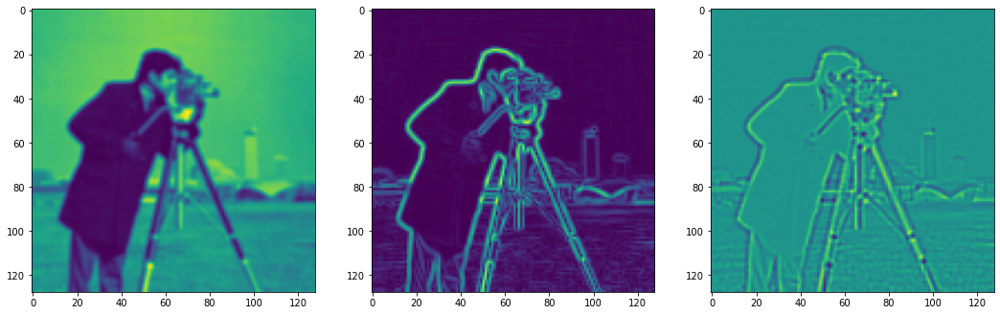

Step 620, Total loss 0.013655, iteration time 0.001882


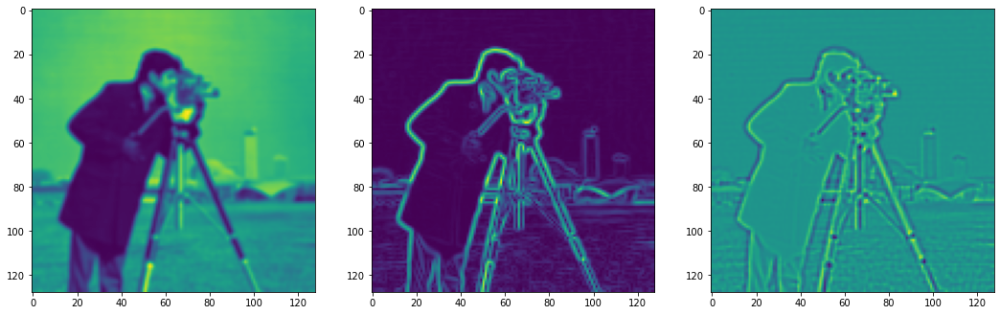

Step 630, Total loss 0.023924, iteration time 0.001882


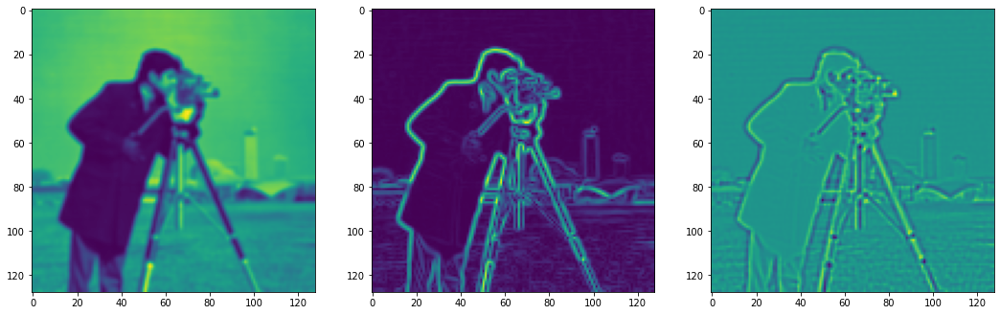

Step 640, Total loss 0.016772, iteration time 0.001855


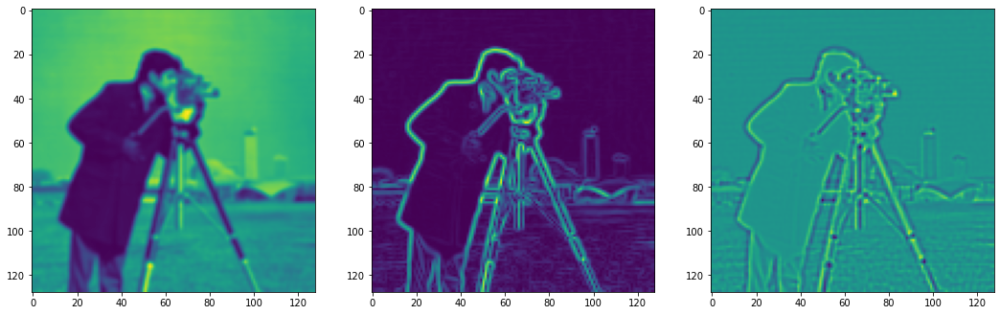

Step 650, Total loss 0.013180, iteration time 0.002044


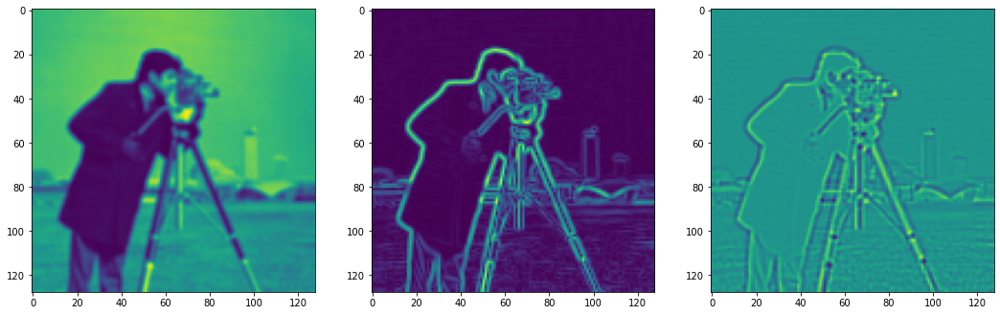

Step 660, Total loss 0.011946, iteration time 0.002042


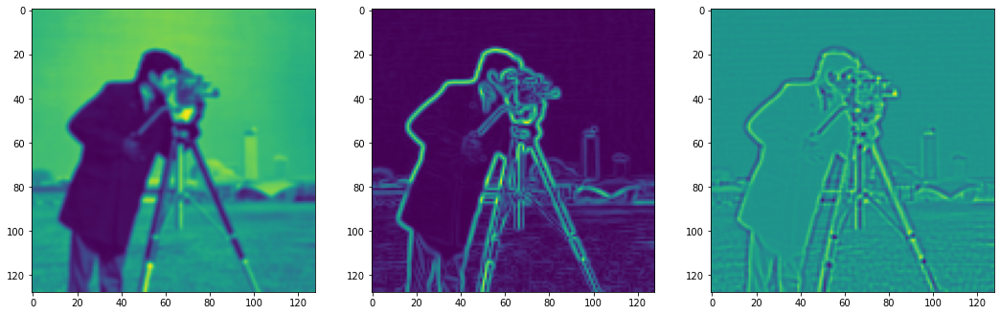

Step 670, Total loss 0.011555, iteration time 0.002241


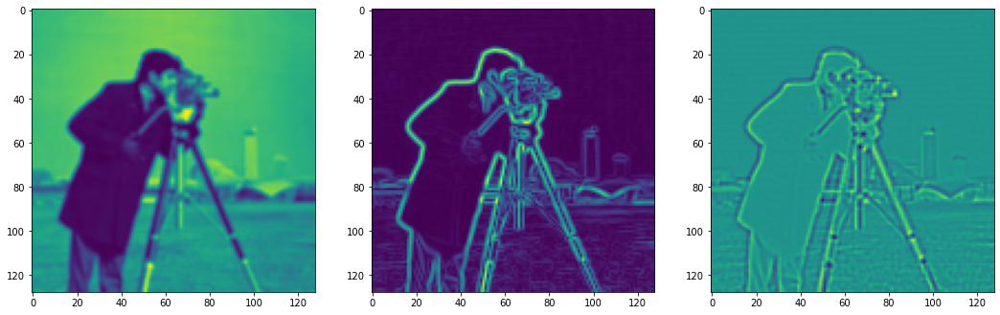

Step 680, Total loss 0.011191, iteration time 0.002393


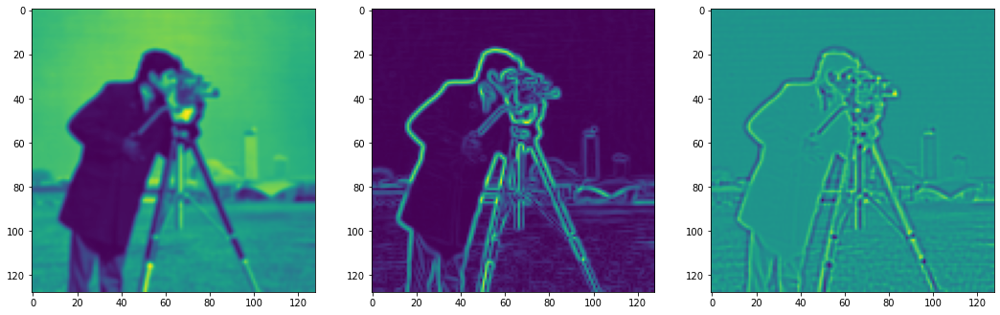

Step 690, Total loss 0.010946, iteration time 0.003857


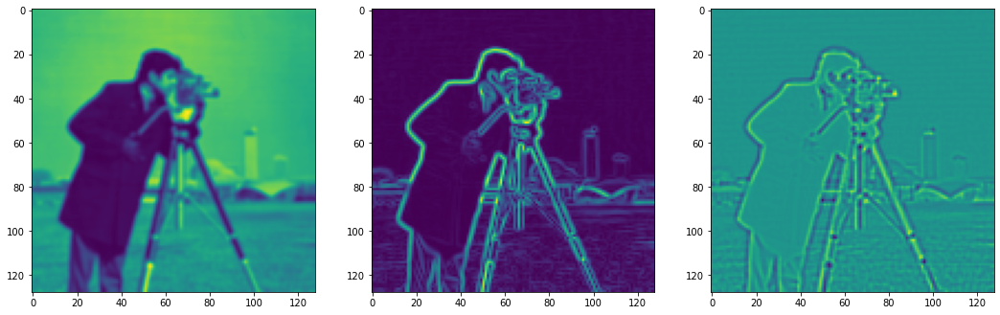

Step 700, Total loss 0.010745, iteration time 0.002302


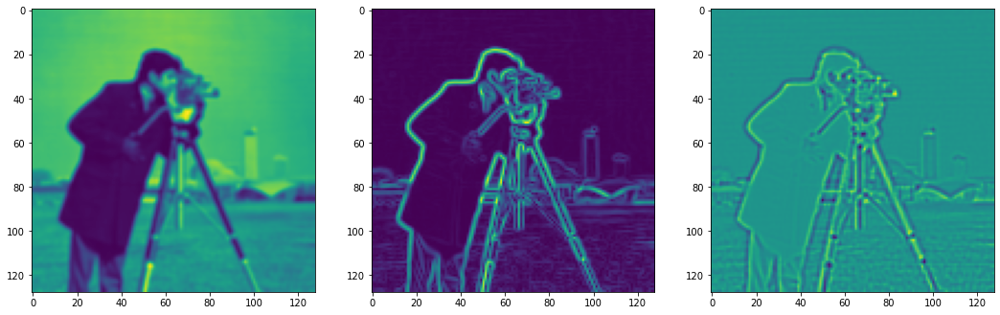

Step 710, Total loss 0.010559, iteration time 0.002810


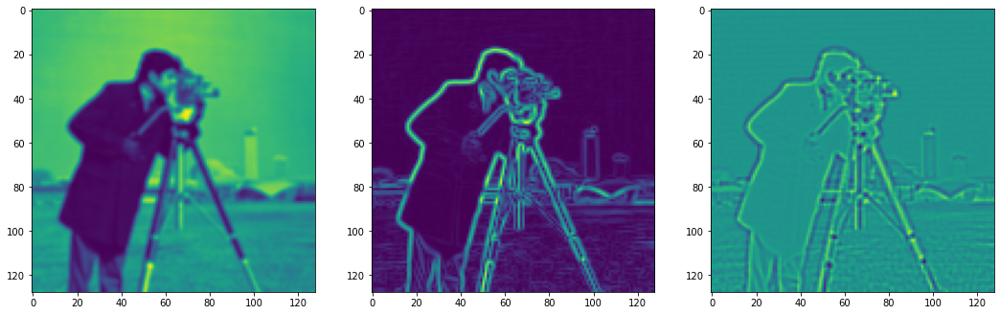

Step 720, Total loss 0.010602, iteration time 0.002076


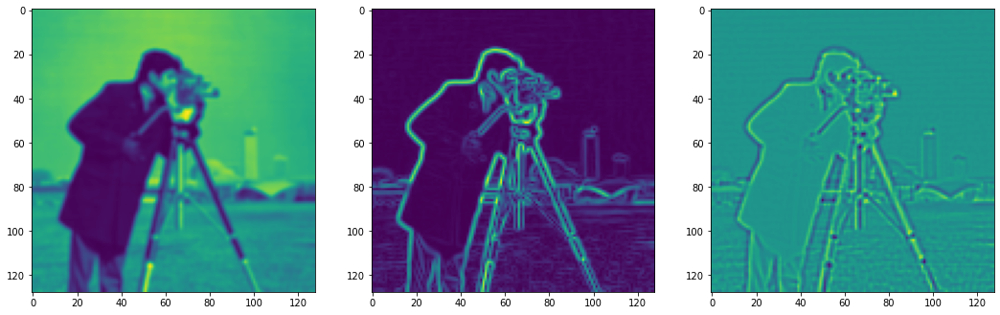

Step 730, Total loss 0.034436, iteration time 0.002111


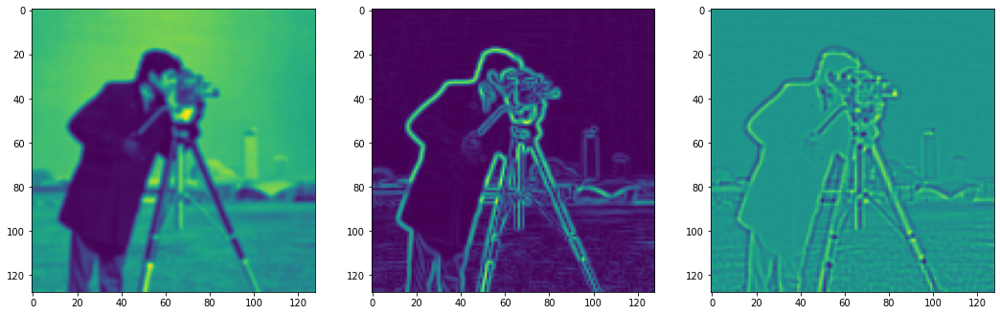

Step 740, Total loss 0.014740, iteration time 0.002065


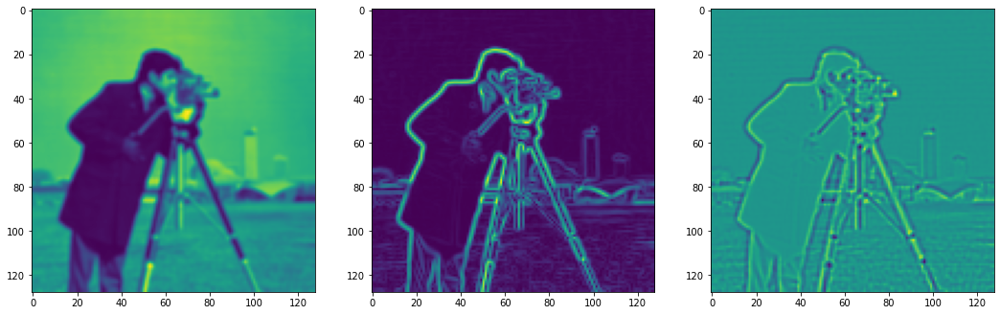

Step 750, Total loss 0.011363, iteration time 0.002368


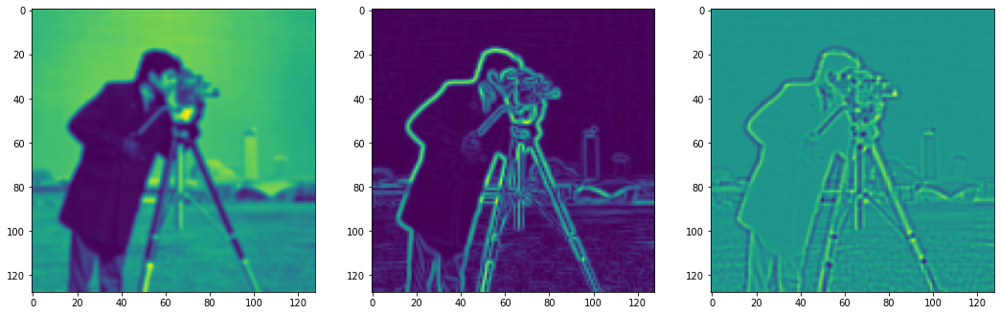

Step 760, Total loss 0.010296, iteration time 0.002008


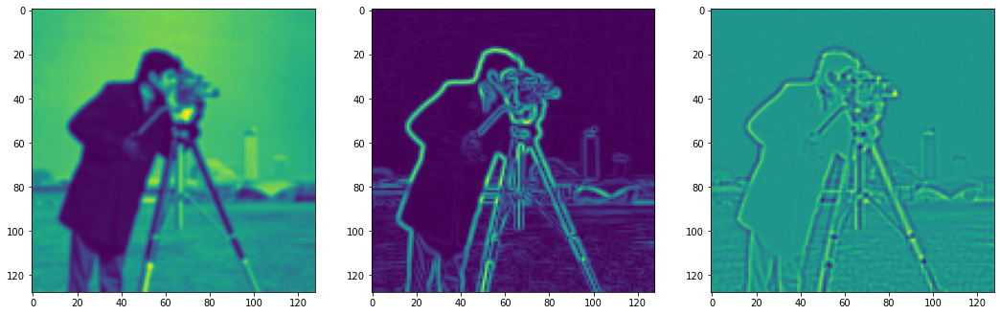

Step 770, Total loss 0.009761, iteration time 0.002093


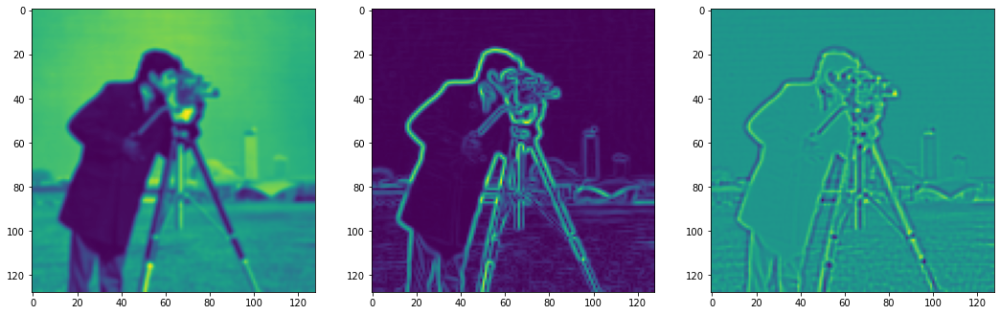

Step 780, Total loss 0.009467, iteration time 0.002183


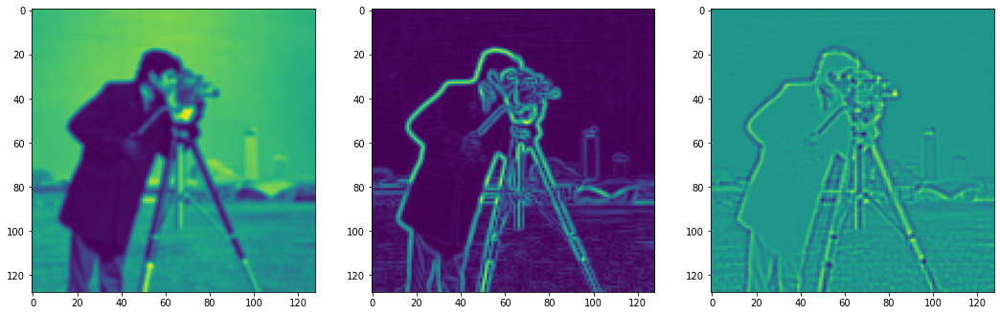

Step 790, Total loss 0.009952, iteration time 0.001995


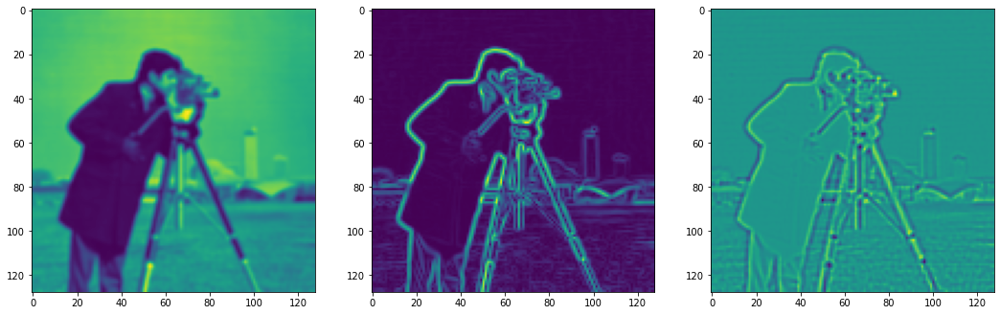

Step 800, Total loss 0.022370, iteration time 0.001900


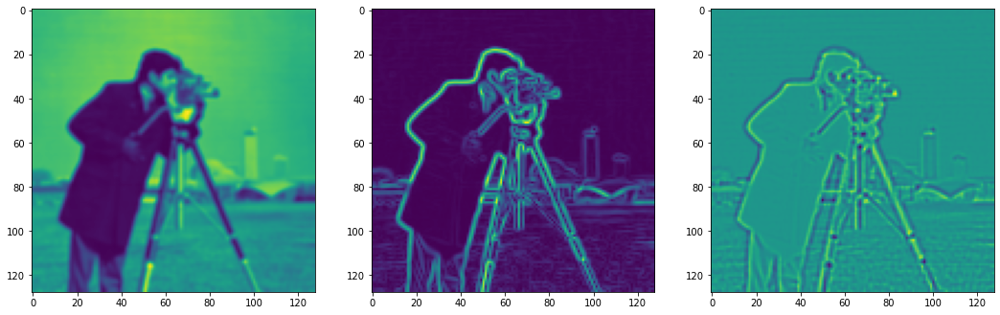

Step 810, Total loss 0.013715, iteration time 0.001911


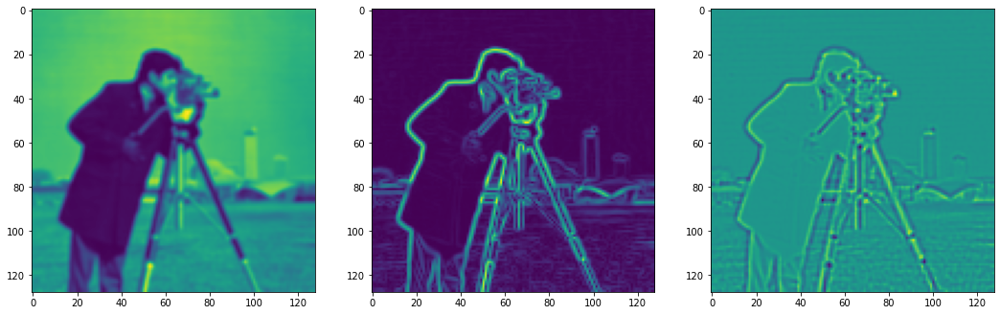

Step 820, Total loss 0.009555, iteration time 0.003067


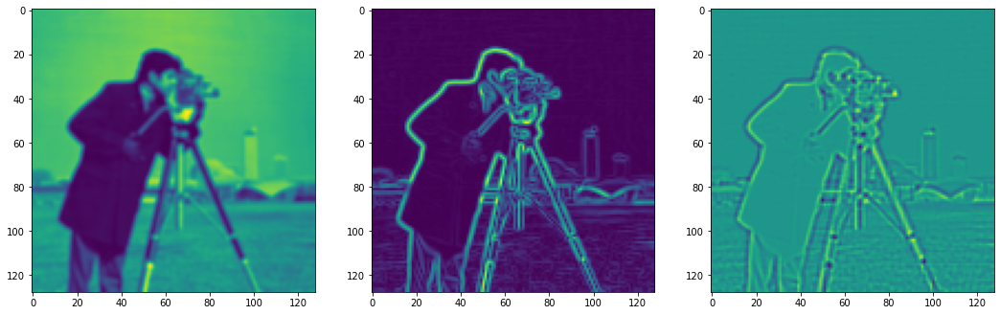

Step 830, Total loss 0.008802, iteration time 0.001904


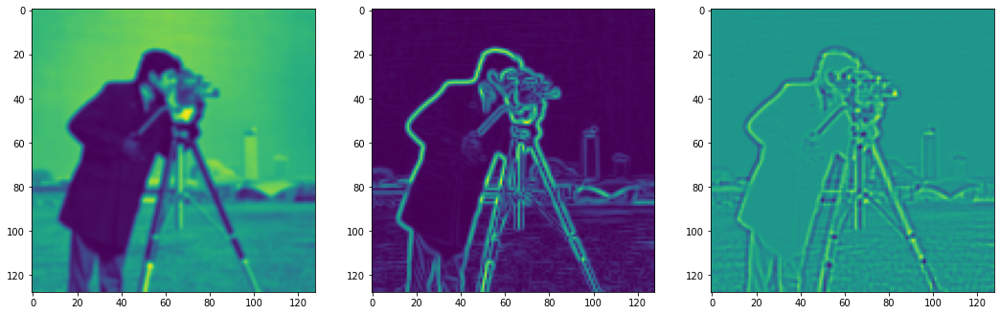

Step 840, Total loss 0.008516, iteration time 0.001894


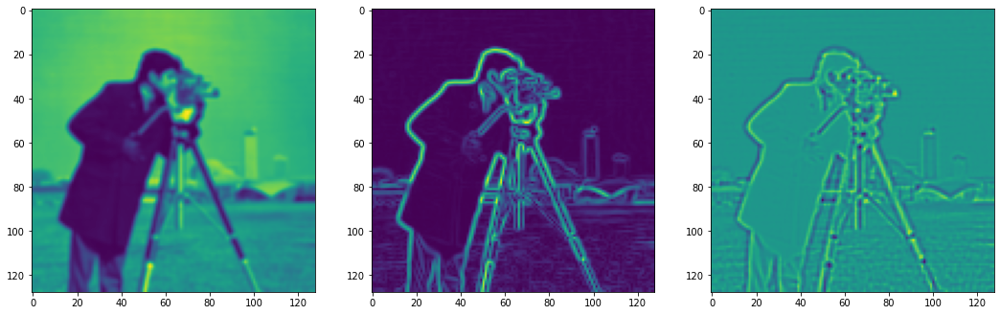

Step 850, Total loss 0.008360, iteration time 0.002552


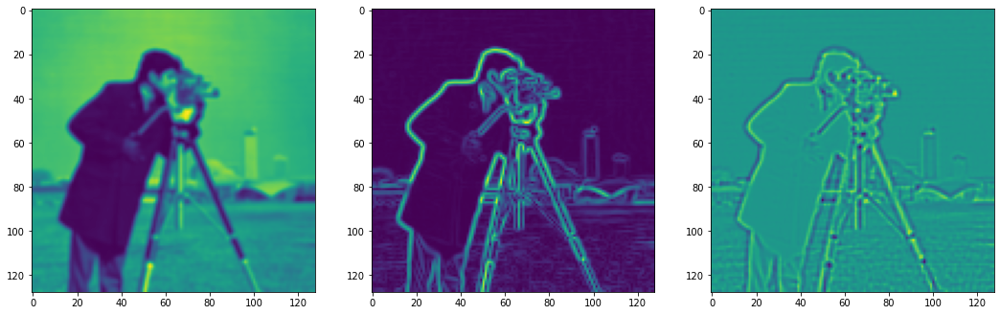

Step 860, Total loss 0.008165, iteration time 0.002104


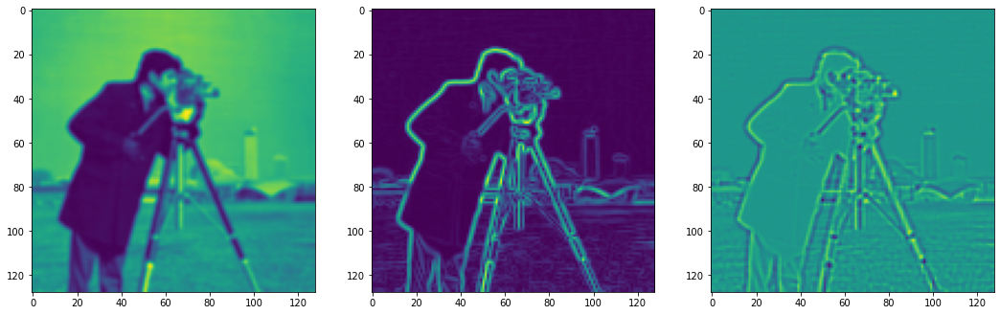

Step 870, Total loss 0.008074, iteration time 0.001979


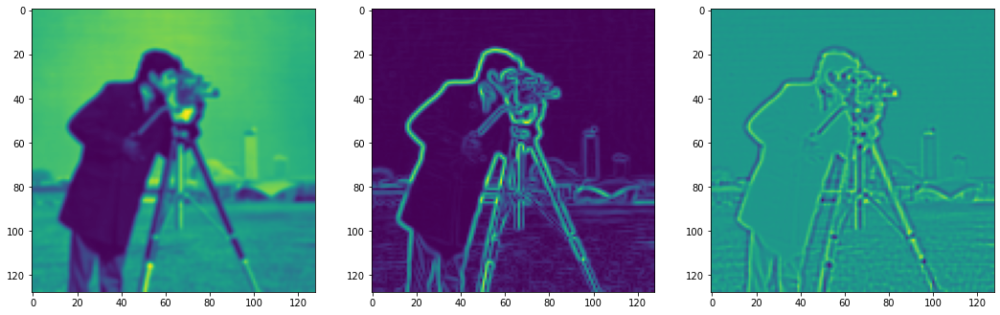

Step 880, Total loss 0.010235, iteration time 0.001903


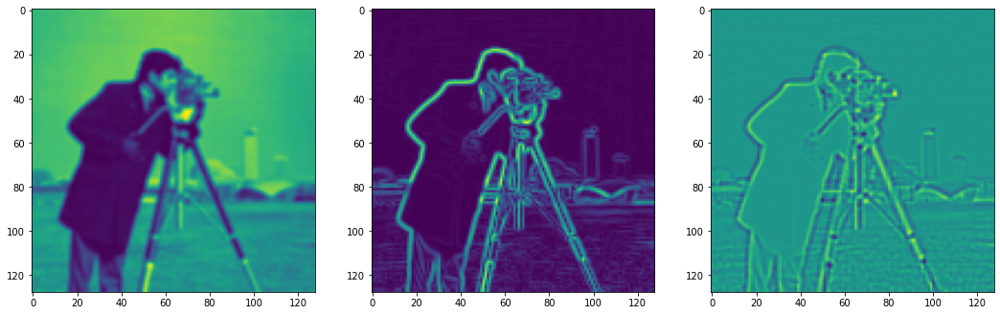

Step 890, Total loss 0.023739, iteration time 0.001851


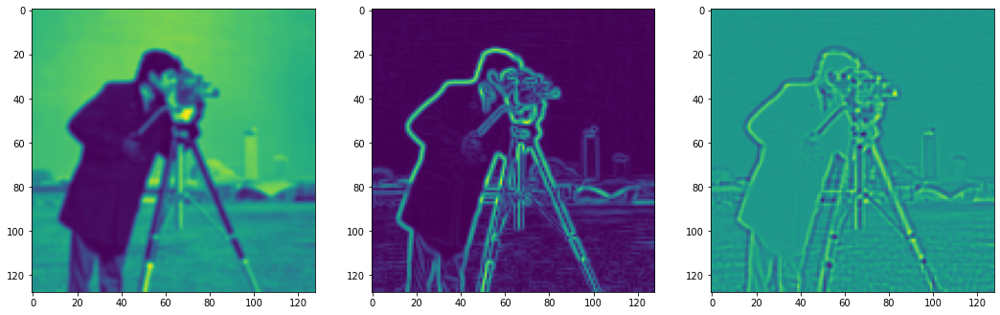

Step 900, Total loss 0.013288, iteration time 0.001901


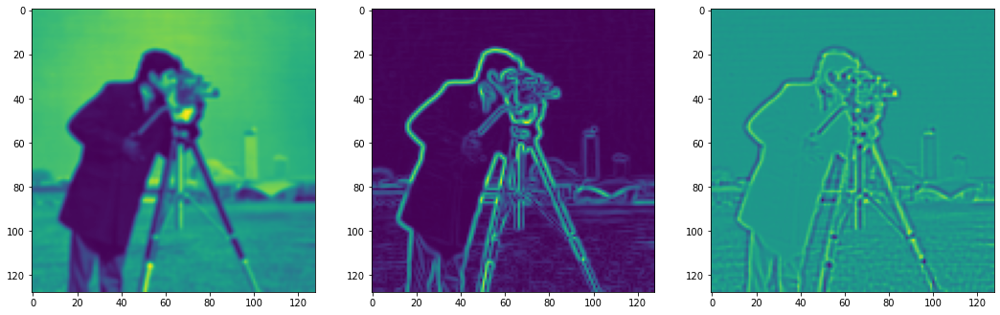

Step 910, Total loss 0.008296, iteration time 0.001930


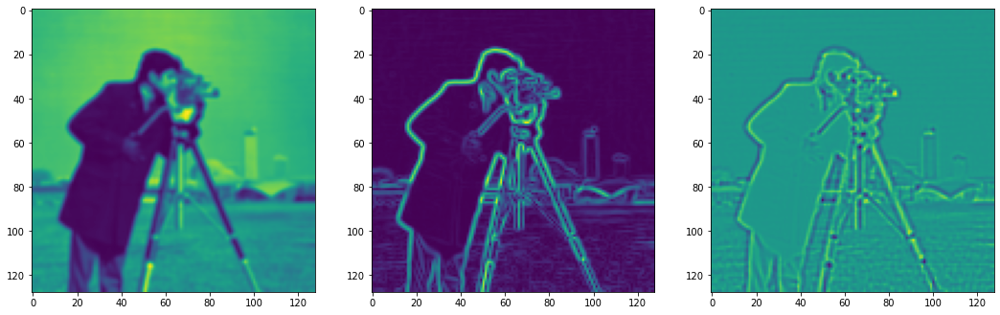

Step 920, Total loss 0.007767, iteration time 0.002187


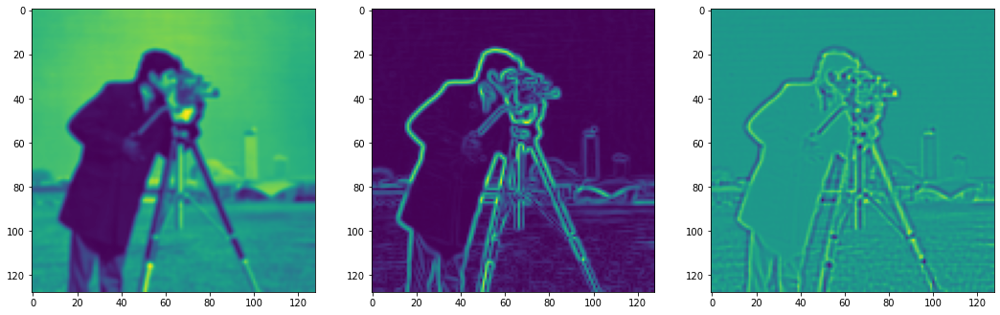

Step 930, Total loss 0.007445, iteration time 0.001894


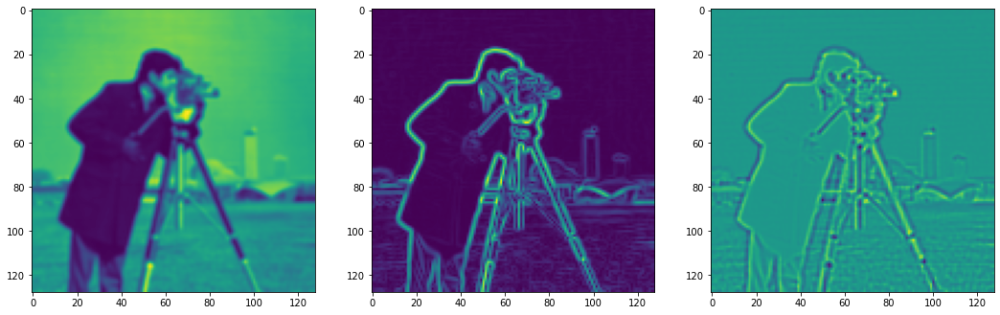

Step 940, Total loss 0.007206, iteration time 0.001912


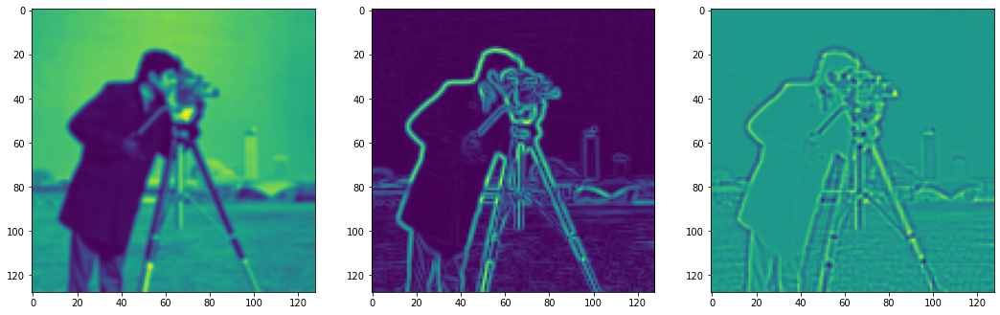

Step 950, Total loss 0.007096, iteration time 0.001897


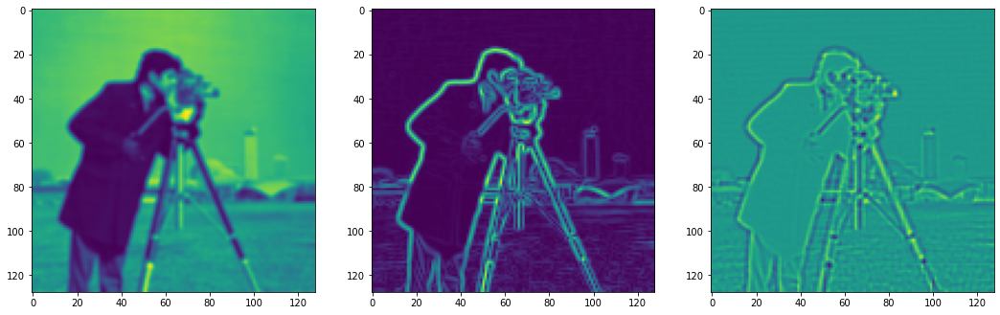

Step 960, Total loss 0.008420, iteration time 0.001907


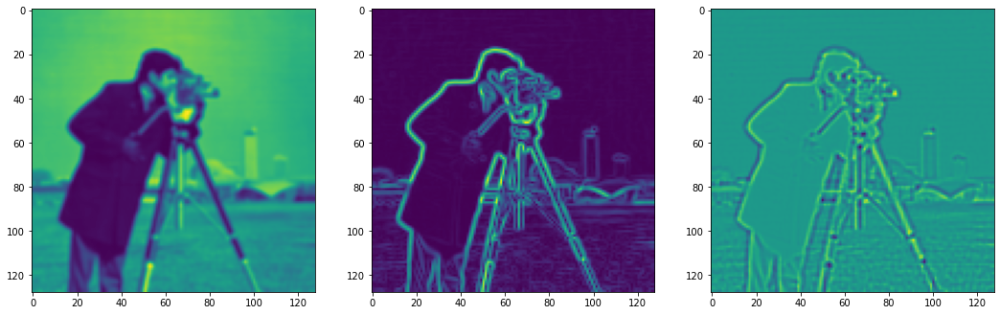

Step 970, Total loss 0.017890, iteration time 0.001890


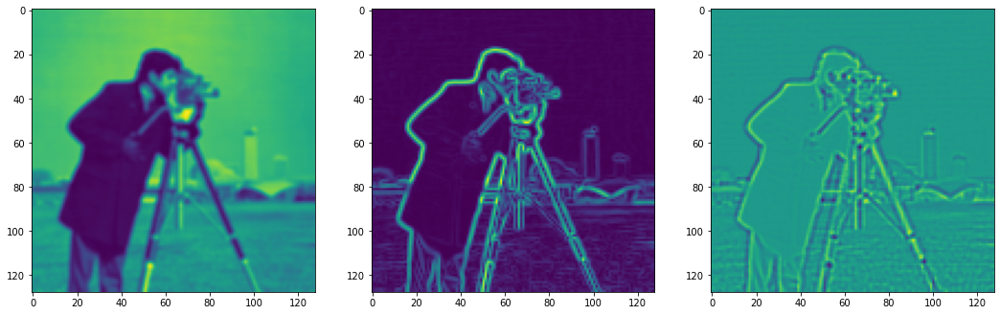

Step 980, Total loss 0.009073, iteration time 0.001945


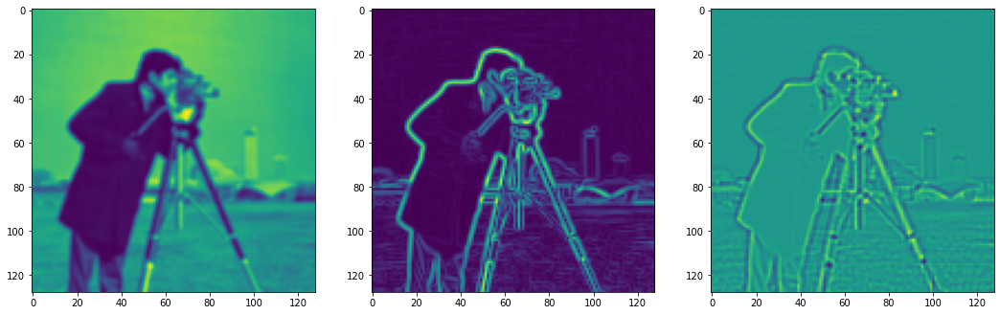

Step 990, Total loss 0.007255, iteration time 0.002925


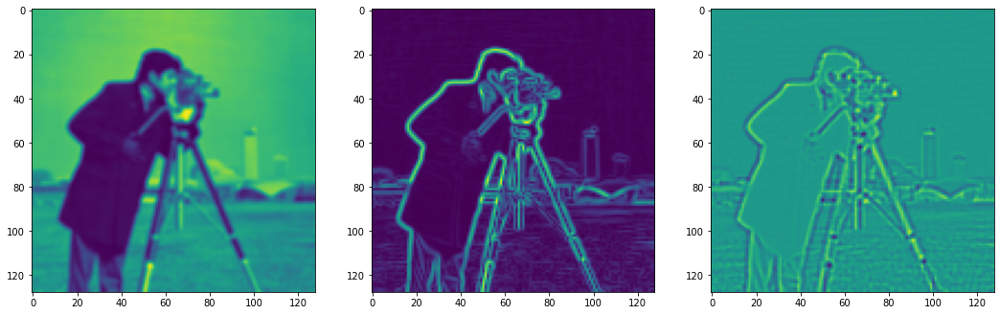

In [ ]:
total_steps = 1000
steps_til_summary = 10

optim = torch.optim.Adam(lr=1e-4, params=poisson_siren.parameters())

model_input, gt = next(iter(dataloader))
gt = {key: value.cuda() for key, value in gt.items()}
model_input = model_input.cuda()

for step in range(total_steps):
    start_time = time.time()

    model_output, coords = poisson_siren(model_input)
    train_loss = gradients_mse(model_output, coords, gt['grads'])

    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f, iteration time %0.6f" % (step, train_loss, time.time() - start_time))

        img_grad = gradient(model_output, coords)
        img_laplacian = laplace(model_output, coords)

        fig, axes = plt.subplots(1, 3, figsize=(18, 6))
        axes[0].imshow(model_output.cpu().view(128,128).detach().numpy())
        axes[1].imshow(img_grad.cpu().norm(dim=-1).view(128,128).detach().numpy())
        axes[2].imshow(img_laplacian.cpu().view(128,128).detach().numpy())
        plt.show()
        
    optim.zero_grad()
    train_loss.backward()
    optim.step()

<a id='activations'></a>
## Initialization scheme & distribution of activations

We now reproduce the empirical result on the distribution of activations, and will thereafter show empirically that the distribution of activations is shift-invariant as well! 

In [ ]:
from collections import OrderedDict
import matplotlib
import numpy.fft as fft
import scipy.stats as stats


def eformat(f, prec, exp_digits):
    s = "%.*e"%(prec, f)
    mantissa, exp = s.split('e')
    # add 1 to digits as 1 is taken by sign +/-
    return "%se%+0*d"%(mantissa, exp_digits+1, int(exp))

def format_x_ticks(x, pos):
    """Format odd tick positions
    """
    return eformat(x, 0, 1)

def format_y_ticks(x, pos):
    """Format odd tick positions
    """
    return eformat(x, 0, 1)

def get_spectrum(activations):
    n = activations.shape[0]

    spectrum = fft.fft(activations.numpy().astype(np.double).sum(axis=-1), axis=0)[:n//2]
    spectrum = np.abs(spectrum)

    max_freq = 100                
    freq = fft.fftfreq(n, 2./n)[:n//2]
    return freq[:max_freq], spectrum[:max_freq]


def plot_all_activations_and_grads(activations):
    num_cols = 4
    num_rows = len(activations)
    
    fig_width = 5.5
    fig_height = num_rows/num_cols*fig_width
    fig_height = 9
    
    fontsize = 5
        
    fig, axs = plt.subplots(num_rows, num_cols, gridspec_kw={'hspace': 0.3, 'wspace': 0.2},
                            figsize=(fig_width, fig_height), dpi=300)
    
    axs[0][0].set_title("Activation Distribution", fontsize=7, fontfamily='serif', pad=5.)
    axs[0][1].set_title("Activation Spectrum", fontsize=7, fontfamily='serif', pad=5.)
    axs[0][2].set_title("Gradient Distribution", fontsize=7, fontfamily='serif', pad=5.)
    axs[0][3].set_title("Gradient Spectrum", fontsize=7, fontfamily='serif', pad=5.)

    x_formatter = matplotlib.ticker.FuncFormatter(format_x_ticks)
    y_formatter = matplotlib.ticker.FuncFormatter(format_y_ticks)

    spec_rows = []
    for idx, (key, value) in enumerate(activations.items()):    
        grad_value = value.grad.cpu().detach().squeeze(0)
        flat_grad = grad_value.view(-1)
        axs[idx][2].hist(flat_grad, bins=256, density=True)
        
        value = value.cpu().detach().squeeze(0) # (1, num_points, 256)
        n = value.shape[0]
        flat_value = value.view(-1)
            
        axs[idx][0].hist(flat_value, bins=256, density=True)
                
        if idx>1:
            if not (idx)%2:
                x = np.linspace(-1, 1., 500)
                axs[idx][0].plot(x, stats.arcsine.pdf(x, -1, 2), 
                                 linestyle=':', markersize=0.4, zorder=2)
            else:
                mu = 0
                variance = 1
                sigma = np.sqrt(variance)
                x = np.linspace(mu - 3*sigma, mu + 3*sigma, 500)
                axs[idx][0].plot(x, stats.norm.pdf(x, mu, sigma), 
                                 linestyle=':', markersize=0.4, zorder=2)
        
        activ_freq, activ_spec = get_spectrum(value)
        axs[idx][1].plot(activ_freq, activ_spec)
        
        grad_freq, grad_spec = get_spectrum(grad_value)
        axs[idx][-1].plot(grad_freq, grad_spec)
        
        for ax in axs[idx]:
            ax.tick_params(axis='both', which='major', direction='in',
                                    labelsize=fontsize, pad=1., zorder=10) 
            ax.tick_params(axis='x', labelrotation=0, pad=1.5, zorder=10) 

            ax.xaxis.set_major_formatter(x_formatter)
            ax.yaxis.set_major_formatter(y_formatter)

/usr/local/lib/python3.6/dist-packages/scipy/stats/_continuous_distns.py:422: RuntimeWarning: divide by zero encountered in true_divide
  return 1.0/np.pi/np.sqrt(x*(1-x))
/usr/local/lib/python3.6/dist-packages/scipy/stats/_continuous_distns.py:422: RuntimeWarning: divide by zero encountered in true_divide
  return 1.0/np.pi/np.sqrt(x*(1-x))
/usr/local/lib/python3.6/dist-packages/scipy/stats/_continuous_distns.py:422: RuntimeWarning: divide by zero encountered in true_divide
  return 1.0/np.pi/np.sqrt(x*(1-x))
/usr/local/lib/python3.6/dist-packages/scipy/stats/_continuous_distns.py:422: RuntimeWarning: divide by zero encountered in true_divide
  return 1.0/np.pi/np.sqrt(x*(1-x))
/usr/local/lib/python3.6/dist-packages/scipy/stats/_continuous_distns.py:422: RuntimeWarning: divide by zero encountered in true_divide
  return 1.0/np.pi/np.sqrt(x*(1-x))
/usr/local/lib/python3.6/dist-packages/scipy/stats/_continuous_distns.py:422: RuntimeWarning: divide by zero encountered in true_divide
  re

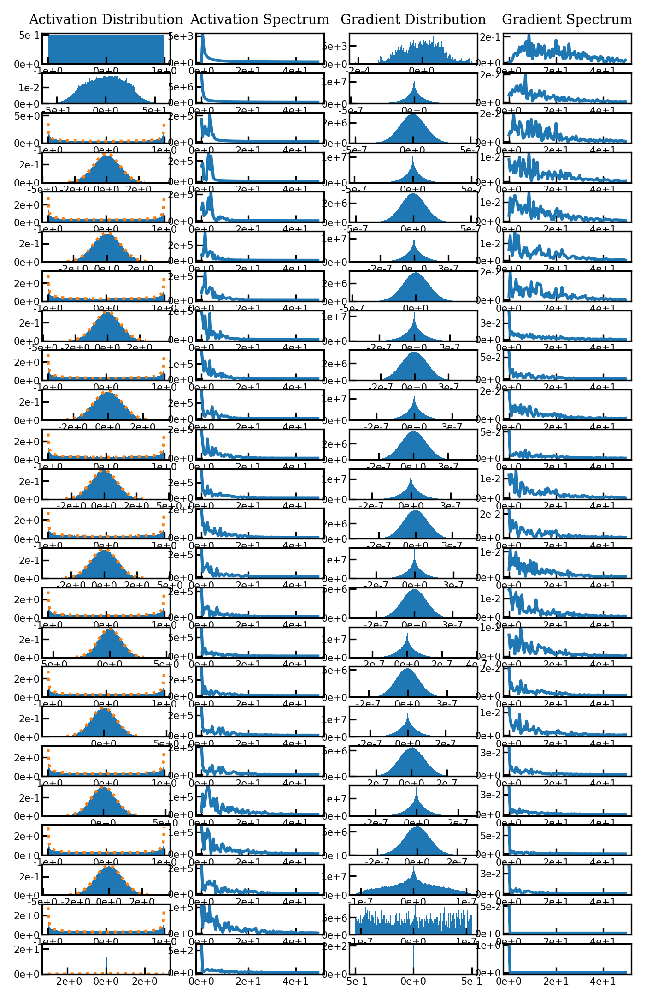

In [ ]:
model = Siren(in_features=1, hidden_features=2048, 
              hidden_layers=10, out_features=1, outermost_linear=True)

input_signal = torch.linspace(-1, 1, 65536//4).view(1, 65536//4, 1)
activations = model.forward_with_activations(input_signal, retain_grad=True)
output = activations[next(reversed(activations))]

# Compute gradients. Because we have retain_grad=True on 
# activations, each activation stores its own gradient!
output.mean().backward()

plot_all_activations_and_grads(activations)

Note how the activations of Siren always alternate between a standard normal distribution with standard deviation one, and an arcsine distribution. If you have a beefy computer, you can put this to the extreme and increase the number of layers - this property holds even for more than 50 layers!

<a id='shift_invariance'></a>
## Distribution of activations is shift-invariant

One of the key properties of the periodic sine nonlinearity is that it affords a degree of shift-invariance. Consider the first layer of a Siren: You can convince yourself that this layer can easily learn to map two different coordinates to *the same set of activations*. This means that whatever layers come afterwards will apply the same function to these two sets of coordinates.

Moreoever, the distribution of activations similarly are shift-invariant. Let's shift our input signal by 1000 and re-compute the activations:

In [ ]:
input_signal = torch.linspace(-1, 1, 65536//4).view(1, 65536//4, 1) + 1000
activations = model.forward_with_activations(input_signal, retain_grad=True)
output = activations[next(reversed(activations))]

# Compute gradients. Because we have retain_grad=True on 
# activations, each activation stores its own gradient!
output.mean().backward()

plot_all_activations_and_grads(activations)

As we can see, the distributions of activations didn't change at all - they are perfectly invariant to the shift.